# DeepDreaming with TensorFlow

Original Code Base [here](https://github.com/tensorflow/tensorflow/blob/master/tensorflow/examples/tutorials/deepdream/deepdream.ipynb)

### New Content

- [New Content and Deep Dream analysis](#newcontent)

- [Visualizing layers](#visualize)

In [3]:
# boilerplate code
from __future__ import print_function
import os
from io import BytesIO
import numpy as np
from functools import partial
import PIL.Image
from IPython.display import clear_output, Image, display, HTML

import tensorflow as tf

<a id='loading'></a>
## Loading and displaying the model graph

The pretrained network can be downloaded [here](https://storage.googleapis.com/download.tensorflow.org/models/inception5h.zip). Unpack the `tensorflow_inception_graph.pb` file from the archive and set its path to `model_fn` variable. Alternatively you can uncomment and run the following cell to download the network:

In [6]:
!wget -nc https://storage.googleapis.com/download.tensorflow.org/models/inception5h.zip && unzip -n inception5h.zip

File 'inception5h.zip' already there; not retrieving.

Archive:  inception5h.zip


In [7]:
model_fn = 'tensorflow_inception_graph.pb'

# creating TensorFlow session and loading the model
graph = tf.Graph()
sess = tf.InteractiveSession(graph=graph)
with tf.gfile.FastGFile(model_fn, 'rb') as f:
    graph_def = tf.GraphDef()
    graph_def.ParseFromString(f.read())
t_input = tf.placeholder(np.float32, name='input') # define the input tensor
imagenet_mean = 117.0
t_preprocessed = tf.expand_dims(t_input-imagenet_mean, 0)
tf.import_graph_def(graph_def, {'input':t_preprocessed})

To take a glimpse into the kinds of patterns that the network learned to recognize, we will try to generate images that maximize the sum of activations of particular channel of a particular convolutional layer of the neural network. The network we explore contains many convolutional layers, each of which outputs tens to hundreds of feature channels, so we have plenty of patterns to explore.

In [8]:
layers = [op.name for op in graph.get_operations() if op.type=='Conv2D' and 'import/' in op.name]
feature_nums = [int(graph.get_tensor_by_name(name+':0').get_shape()[-1]) for name in layers]

print('Number of layers', len(layers))
print('Total number of feature channels:', sum(feature_nums))


# Helper functions for TF Graph visualization

def strip_consts(graph_def, max_const_size=32):
    """Strip large constant values from graph_def."""
    strip_def = tf.GraphDef()
    for n0 in graph_def.node:
        n = strip_def.node.add() 
        n.MergeFrom(n0)
        if n.op == 'Const':
            tensor = n.attr['value'].tensor
            size = len(tensor.tensor_content)
            if size > max_const_size:
                tensor.tensor_content = tf.compat.as_bytes("<stripped %d bytes>"%size)
    return strip_def
  
def rename_nodes(graph_def, rename_func):
    res_def = tf.GraphDef()
    for n0 in graph_def.node:
        n = res_def.node.add() 
        n.MergeFrom(n0)
        n.name = rename_func(n.name)
        for i, s in enumerate(n.input):
            n.input[i] = rename_func(s) if s[0]!='^' else '^'+rename_func(s[1:])
    return res_def
  
def show_graph(graph_def, max_const_size=32):
    """Visualize TensorFlow graph."""
    if hasattr(graph_def, 'as_graph_def'):
        graph_def = graph_def.as_graph_def()
    strip_def = strip_consts(graph_def, max_const_size=max_const_size)
    code = """
        <script>
          function load() {{
            document.getElementById("{id}").pbtxt = {data};
          }}
        </script>
        <link rel="import" href="https://tensorboard.appspot.com/tf-graph-basic.build.html" onload=load()>
        <div style="height:600px">
          <tf-graph-basic id="{id}"></tf-graph-basic>
        </div>
    """.format(data=repr(str(strip_def)), id='graph'+str(np.random.rand()))
  
    iframe = """
        <iframe seamless style="width:800px;height:620px;border:0" srcdoc="{}"></iframe>
    """.format(code.replace('"', '&quot;'))
    display(HTML(iframe))

# Visualizing the network graph. Be sure expand the "mixed" nodes to see their 
# internal structure. We are going to visualize "Conv2D" nodes.
tmp_def = rename_nodes(graph_def, lambda s:"/".join(s.split('_',1)))
show_graph(tmp_def)

Number of layers 59
Total number of feature channels: 7548


<a id='naive'></a>
## Naive feature visualization

Let's start with a naive way of visualizing these. Image-space gradient ascent!

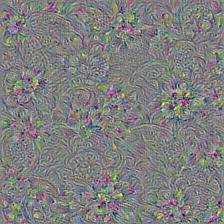

In [9]:
# Picking some internal layer. Note that we use outputs before applying the ReLU nonlinearity
# to have non-zero gradients for features with negative initial activations.
layer = 'mixed4d_3x3_bottleneck_pre_relu'
channel = 139 # picking some feature channel to visualize

# start with a gray image with a little noise
img_noise = np.random.uniform(size=(224,224,3)) + 100.0

def showarray(a, fmt='jpeg'):
    a = np.uint8(np.clip(a, 0, 1)*255)
    f = BytesIO()
    PIL.Image.fromarray(a).save(f, fmt)
    display(Image(data=f.getvalue()))
    
# Angelo wrote this to keep image in memory to translate multiple times.
def getImage(a, fmt='jpeg'):
    a = np.uint8(np.clip(a, 0, 1)*255)
    f = BytesIO()
    PIL.Image.fromarray(a).save(f, fmt)
    return Image(data=f.getvalue())
    
def visstd(a, s=0.1):
    '''Normalize the image range for visualization'''
    return (a-a.mean())/max(a.std(), 1e-4)*s + 0.5

def T(layer):
    '''Helper for getting layer output tensor'''
    return graph.get_tensor_by_name("import/%s:0"%layer)

def render_naive(t_obj, img0=img_noise, iter_n=20, step=1.0):
    t_score = tf.reduce_mean(t_obj) # defining the optimization objective
    t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!
    
    img = img0.copy()
    for i in range(iter_n):
        g, score = sess.run([t_grad, t_score], {t_input:img})
        # normalizing the gradient, so the same step size should work 
        g /= g.std()+1e-8         # for different layers and networks
        img += g*step
        print(score, end = ' ')
    clear_output()
    showarray(visstd(img))

render_naive(T(layer)[:,:,:,channel])

<a id="multiscale"></a>
## Multiscale image generation

Looks like the network wants to show us something interesting! Let's help it. We are going to apply gradient ascent on multiple scales. Details formed on smaller scale will be upscaled and augmented with additional details on the next scale.

With multiscale image generation it may be tempting to set the number of octaves to some high value to produce wallpaper-sized images. Storing network activations and backprop values will quickly run out of GPU memory in this case. There is a simple trick to avoid this: split the image into smaller tiles and compute each tile gradient independently. Applying random shifts to the image before every iteration helps avoid tile seams and improves the overall image quality.

In [10]:
def tffunc(*argtypes):
    '''Helper that transforms TF-graph generating function into a regular one.
    See "resize" function below.
    '''
    placeholders = list(map(tf.placeholder, argtypes))
    def wrap(f):
        out = f(*placeholders)
        def wrapper(*args, **kw):
            return out.eval(dict(zip(placeholders, args)), session=kw.get('session'))
        return wrapper
    return wrap

# Helper function that uses TF to resize an image
def resize(img, size):
    img = tf.expand_dims(img, 0)
    return tf.image.resize_bilinear(img, size)[0,:,:,:]
resize = tffunc(np.float32, np.int32)(resize)


def calc_grad_tiled(img, t_grad, tile_size=512):
    '''Compute the value of tensor t_grad over the image in a tiled way.
    Random shifts are applied to the image to blur tile boundaries over 
    multiple iterations.'''
    sz = tile_size
    h, w = img.shape[:2]
    sx, sy = np.random.randint(sz, size=2)
    img_shift = np.roll(np.roll(img, sx, 1), sy, 0)
    grad = np.zeros_like(img)
    for y in range(0, max(h-sz//2, sz),sz):
        for x in range(0, max(w-sz//2, sz),sz):
            sub = img_shift[y:y+sz,x:x+sz]
            g = sess.run(t_grad, {t_input:sub})
            grad[y:y+sz,x:x+sz] = g
    return np.roll(np.roll(grad, -sx, 1), -sy, 0)

In [11]:
def render_multiscale(t_obj, img0=img_noise, iter_n=10, step=1.0, octave_n=3, octave_scale=1.4):
    t_score = tf.reduce_mean(t_obj) # defining the optimization objective
    t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!
    
    img = img0.copy()
    for octave in range(octave_n):
        if octave>0:
            hw = np.float32(img.shape[:2])*octave_scale
            img = resize(img, np.int32(hw))
        for i in range(iter_n):
            g = calc_grad_tiled(img, t_grad)
            # normalizing the gradient, so the same step size should work 
            g /= g.std()+1e-8         # for different layers and networks
            img += g*step
            print('.', end = ' ')
        clear_output()
        showarray(visstd(img))

<a id="laplacian"></a>
## Laplacian Pyramid Gradient Normalization

This looks better, but the resulting images mostly contain high frequencies. Can we improve it? One way is to add a smoothness prior into the optimization objective. This will effectively blur the image a little every iteration, suppressing the higher frequencies, so that the lower frequencies can catch up. This will require more iterations to produce a nice image. Why don't we just boost lower frequencies of the gradient instead? One way to achieve this is through the [Laplacian pyramid](https://en.wikipedia.org/wiki/Pyramid_%28image_processing%29#Laplacian_pyramid) decomposition. We call the resulting technique _Laplacian Pyramid Gradient Normalization_.

In [12]:
k = np.float32([1,4,6,4,1])
k = np.outer(k, k)
k5x5 = k[:,:,None,None]/k.sum()*np.eye(3, dtype=np.float32)

def lap_split(img):
    '''Split the image into lo and hi frequency components'''
    with tf.name_scope('split'):
        lo = tf.nn.conv2d(img, k5x5, [1,2,2,1], 'SAME')
        lo2 = tf.nn.conv2d_transpose(lo, k5x5*4, tf.shape(img), [1,2,2,1])
        hi = img-lo2
    return lo, hi

def lap_split_n(img, n):
    '''Build Laplacian pyramid with n splits'''
    levels = []
    for i in range(n):
        img, hi = lap_split(img)
        levels.append(hi)
    levels.append(img)
    return levels[::-1]

def lap_merge(levels):
    '''Merge Laplacian pyramid'''
    img = levels[0]
    for hi in levels[1:]:
        with tf.name_scope('merge'):
            img = tf.nn.conv2d_transpose(img, k5x5*4, tf.shape(hi), [1,2,2,1]) + hi
    return img

def normalize_std(img, eps=1e-10):
    '''Normalize image by making its standard deviation = 1.0'''
    with tf.name_scope('normalize'):
        std = tf.sqrt(tf.reduce_mean(tf.square(img)))
        return img/tf.maximum(std, eps)

def lap_normalize(img, scale_n=4):
    '''Perform the Laplacian pyramid normalization.'''
    img = tf.expand_dims(img,0)
    tlevels = lap_split_n(img, scale_n)
    tlevels = list(map(normalize_std, tlevels))
    out = lap_merge(tlevels)
    return out[0,:,:,:]

# Showing the lap_normalize graph with TensorBoard
lap_graph = tf.Graph()
with lap_graph.as_default():
    lap_in = tf.placeholder(np.float32, name='lap_in')
    lap_out = lap_normalize(lap_in)
show_graph(lap_graph)

In [14]:
def render_lapnorm(t_obj, img0=img_noise, visfunc=visstd,
                   iter_n=10, step=1.0, octave_n=3, octave_scale=1.4, lap_n=4):
    t_score = tf.reduce_mean(t_obj) # defining the optimization objective
    t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!
    # build the laplacian normalization graph
    lap_norm_func = tffunc(np.float32)(partial(lap_normalize, scale_n=lap_n))

    img = img0.copy()
    for octave in range(octave_n):
        if octave>0:
            hw = np.float32(img.shape[:2])*octave_scale
            img = resize(img, np.int32(hw))
        for i in range(iter_n):
            g = calc_grad_tiled(img, t_grad)
            g = lap_norm_func(g)
            img += g*step
            print('.', end = ' ')
        clear_output()
        showarray(visfunc(img))

<a id="playing"></a>
## Playing with feature visualizations

We got a nice smooth image using only 10 iterations per octave. In case of running on GPU this takes just a few seconds. Let's try to visualize another channel from the same layer. The network can generate wide diversity of patterns.

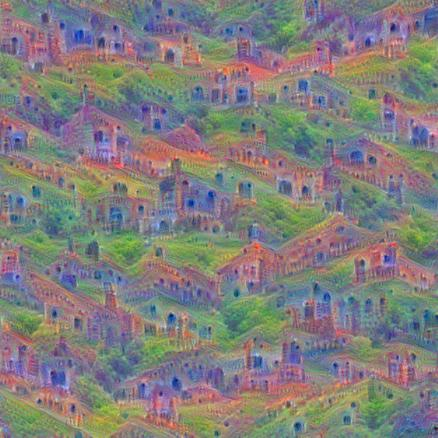

In [17]:
render_lapnorm(T(layer)[:,:,:,65])

Lower layers produce features of lower complexity.

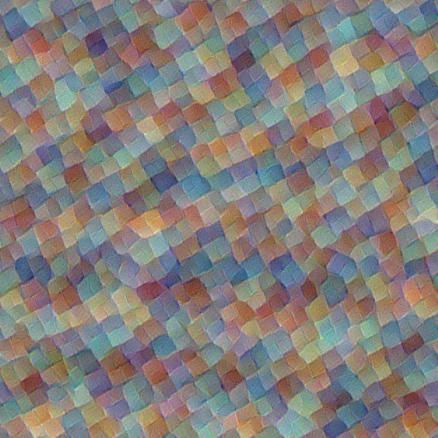

In [18]:
render_lapnorm(T('mixed3b_1x1_pre_relu')[:,:,:,101])

There are many interesting things one may try. For example, optimizing a linear combination of features often gives a "mixture" pattern.

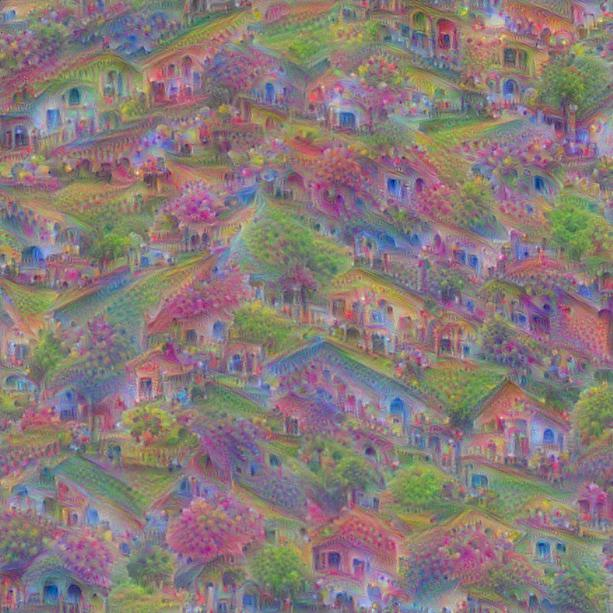

In [19]:
render_lapnorm(T(layer)[:,:,:,65]+T(layer)[:,:,:,139], octave_n=4)

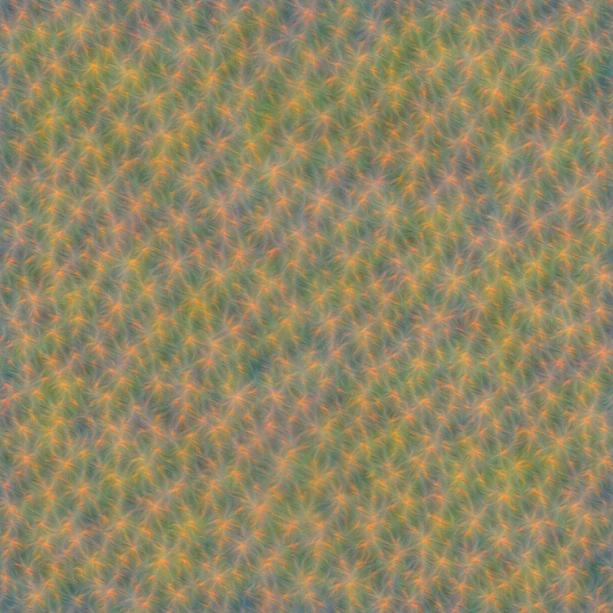

In [20]:
render_lapnorm(T('mixed3b_1x1_pre_relu')[:,:,:,65], octave_n=4)

<a id="deepdream"></a>
## DeepDream

Now let's reproduce the [DeepDream algorithm](https://github.com/google/deepdream/blob/master/dream.ipynb) with TensorFlow. 


In [21]:
def render_deepdream(t_obj, img0=img_noise,
                     iter_n=10, step=1.5, octave_n=4, octave_scale=1.4):
    t_score = tf.reduce_mean(t_obj) # defining the optimization objective
    t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!

    # split the image into a number of octaves
    img = img0
    octaves = []
    for i in range(octave_n-1):
        hw = img.shape[:2]
        lo = resize(img, np.int32(np.float32(hw)/octave_scale))
        hi = img-resize(lo, hw)
        img = lo
        octaves.append(hi)
    
    # generate details octave by octave
    for octave in range(octave_n):
        if octave>0:
            hi = octaves[-octave]
            img = resize(img, hi.shape[:2])+hi
        for i in range(iter_n):
            g = calc_grad_tiled(img, t_grad)
            img += g*(step / (np.abs(g).mean()+1e-7))
            print('.',end = ' ')
        clear_output()
        showarray(img/255.0)
    return img

<a id="newcontent"></a>
# Using da things

Using deep dream, we can start to develop some intuition and relate the mathematics of the algorithm to how objects are represented within the network. 

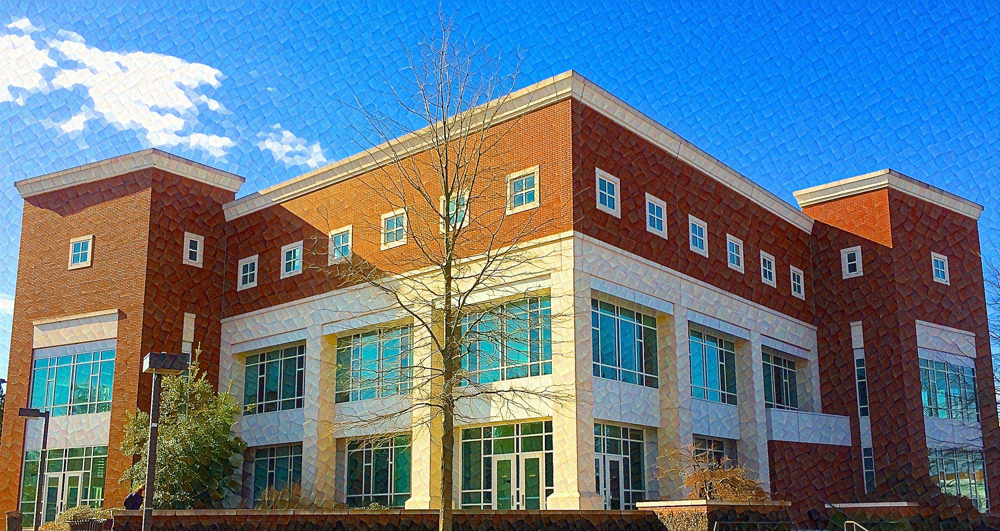

In [15]:
#render_deepdream(T(layer)[:,:,:,139], img0)
imagedata = render_deepdream(T('mixed3b_1x1_pre_relu')[:,:,:,101], img0)

Don't hesitate to use higher resolution inputs (also increase the number of octaves)! Here is an [example](http://storage.googleapis.com/deepdream/pilatus_flowers.jpg) of running the flower dream over the bigger image.

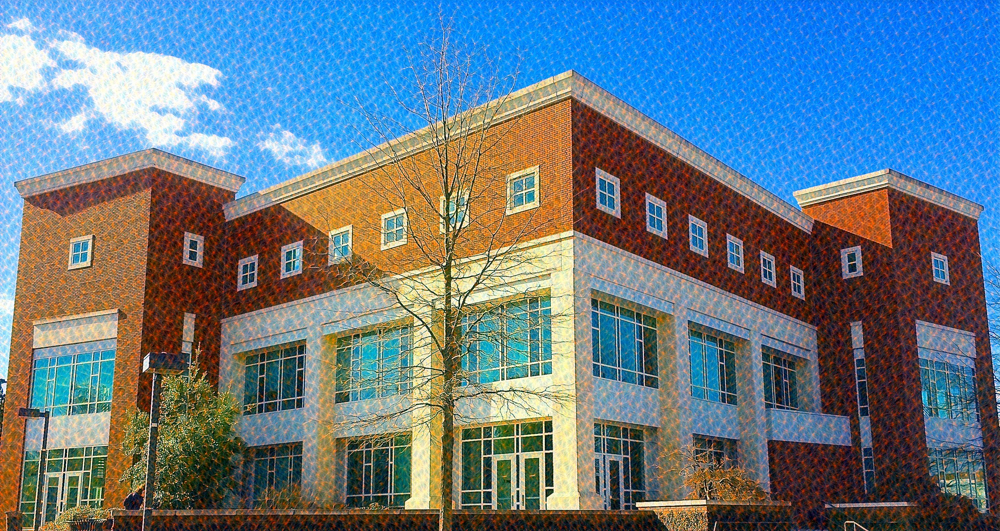

In [16]:
imagedata = render_deepdream(T('mixed3b_1x1_pre_relu')[:,:,:,65], imagedata)

We hope that the visualization tricks described here may be helpful for analyzing representations learned by neural networks or find their use in various artistic applications.

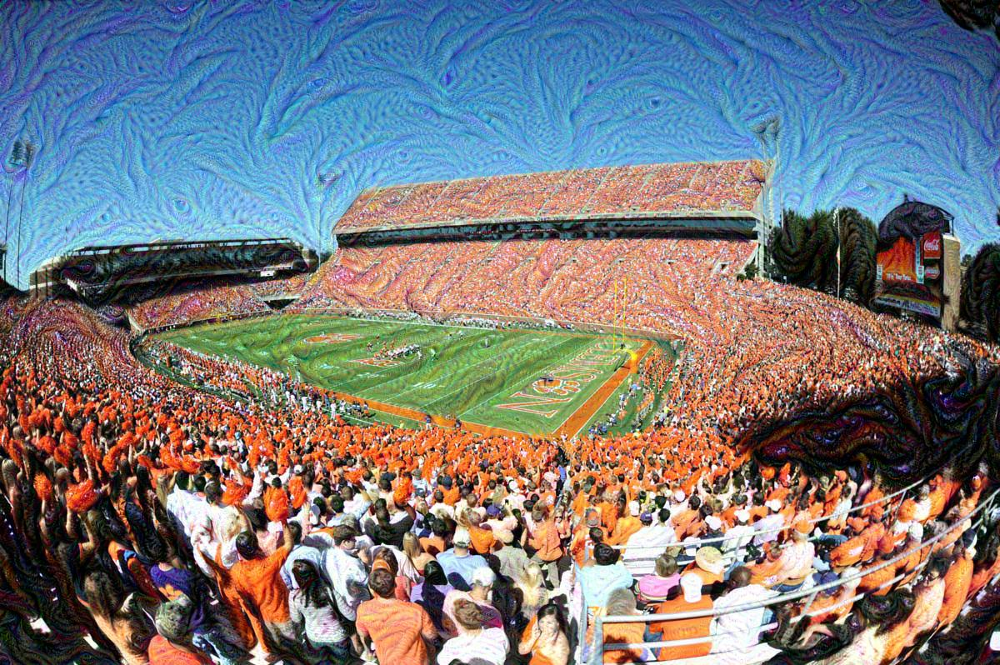

In [36]:
highlevel = render_deepdream(T(layer)[:,:,:,111], img0)

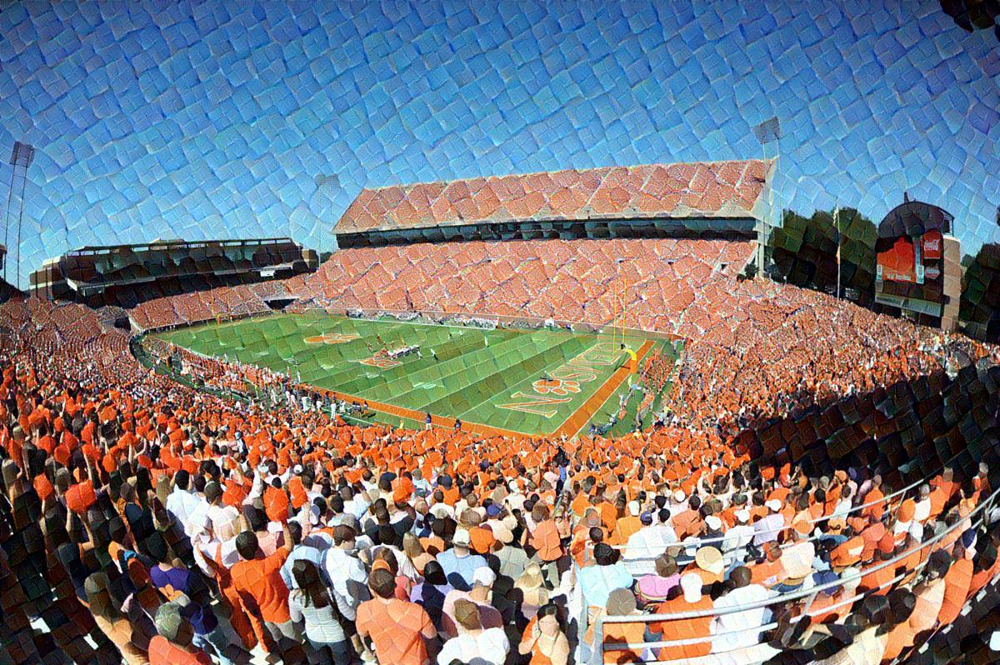

In [41]:
#highlevel = render_deepdream(tf.square(T(layer)[:,:,:,120]), img0)
lowleve = render_deepdream(tf.square(T('mixed3b_1x1_pre_relu')[:,:,:,101]), img0)

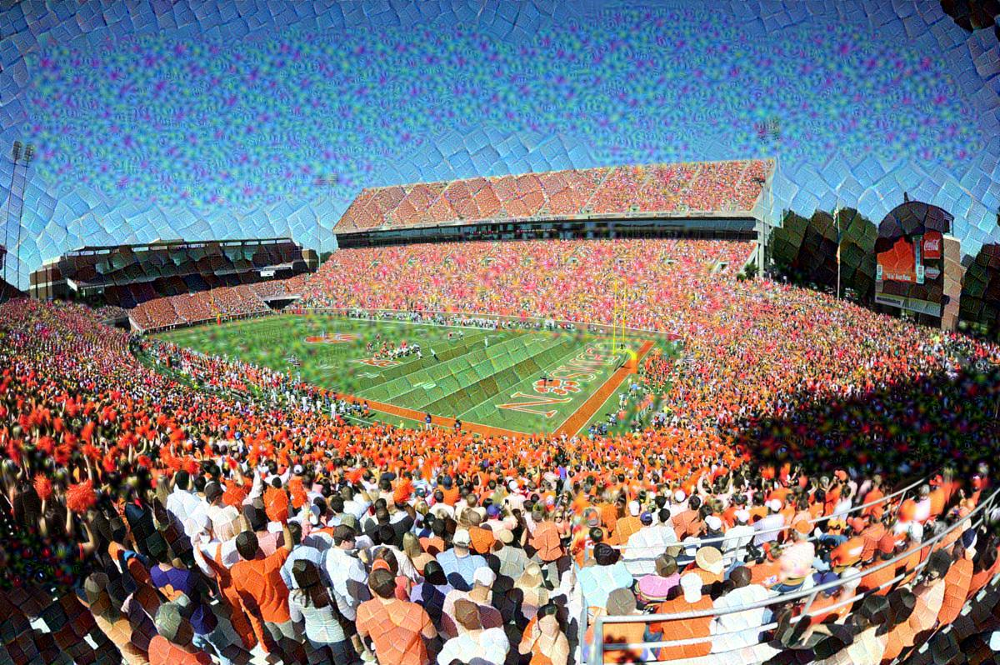

In [43]:
'''
By squaring the optimization matrix, we lose some of 
the ability to represent non-specific features. This results in 
blurry features where there are a lack of parallels with the 
feature we have optimized the network to imprint. 

'''
lowlevel = render_deepdream(tf.square(T('mixed3b_1x1_pre_relu'))[:,:,:,101], img0)

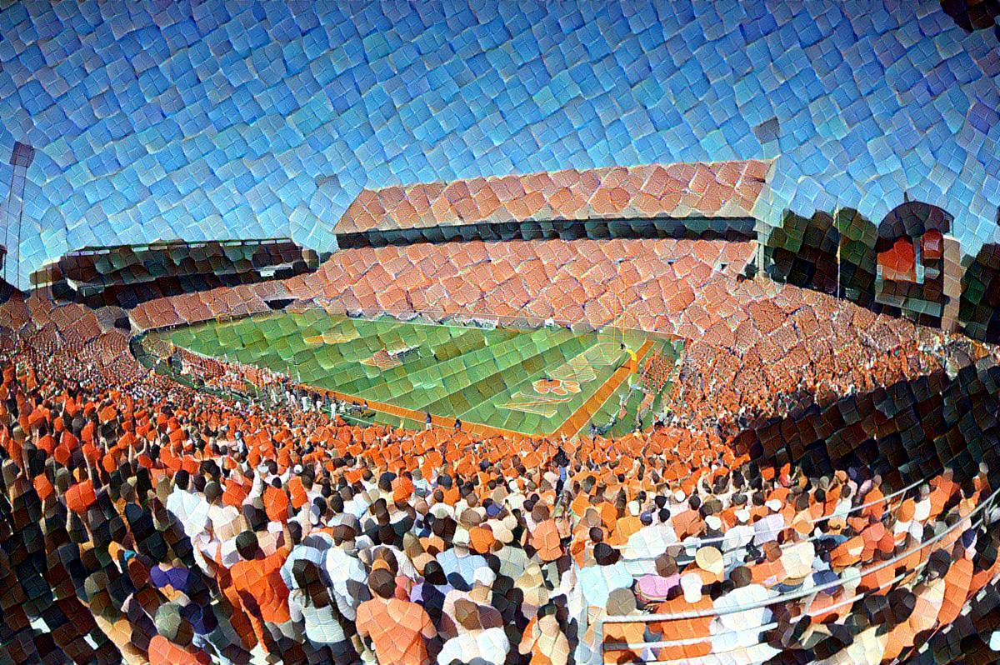

In [44]:
lowlevel = render_deepdream(tf.square(T('mixed3b_1x1_pre_relu')[:,:,:,101]), lowleve)

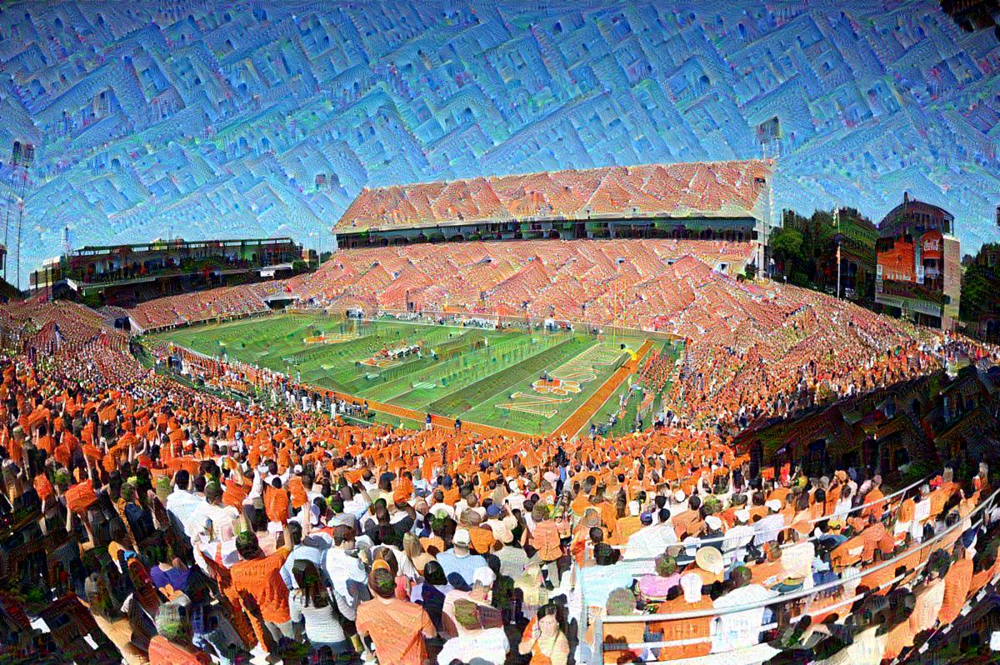

In [45]:
highAndLow = render_deepdream(T(layer)[:,:,:,65], lowleve)

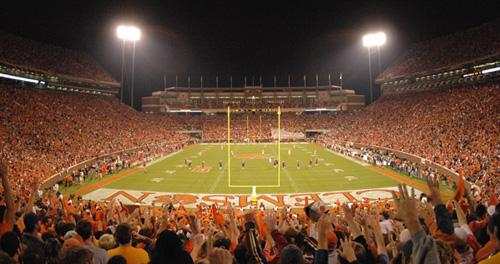

In [48]:
img1 = PIL.Image.open('stadium_500.jpg')
img1 = np.float32(img1)
showarray(img1/255.0)

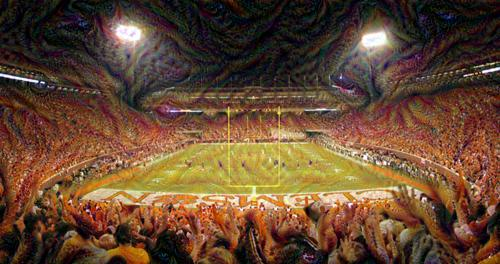

In [49]:
highlevel = render_deepdream(T(layer)[:,:,:,111], img1)

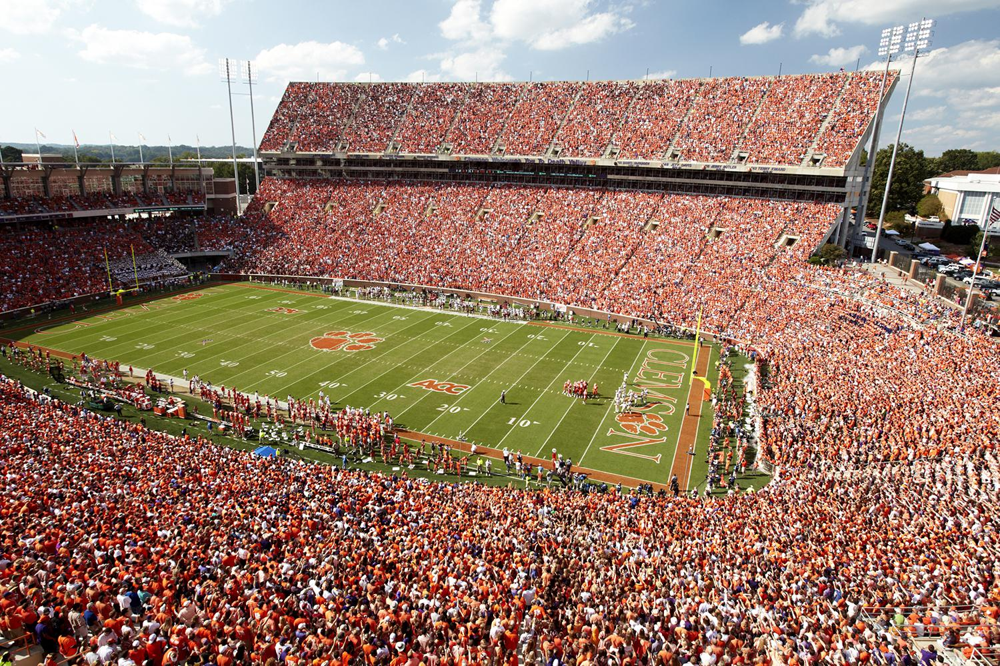

In [37]:
img2 = PIL.Image.open('bigger_stadium.jpg')
img2 = np.float32(img2)
showarray(img2/255.0)

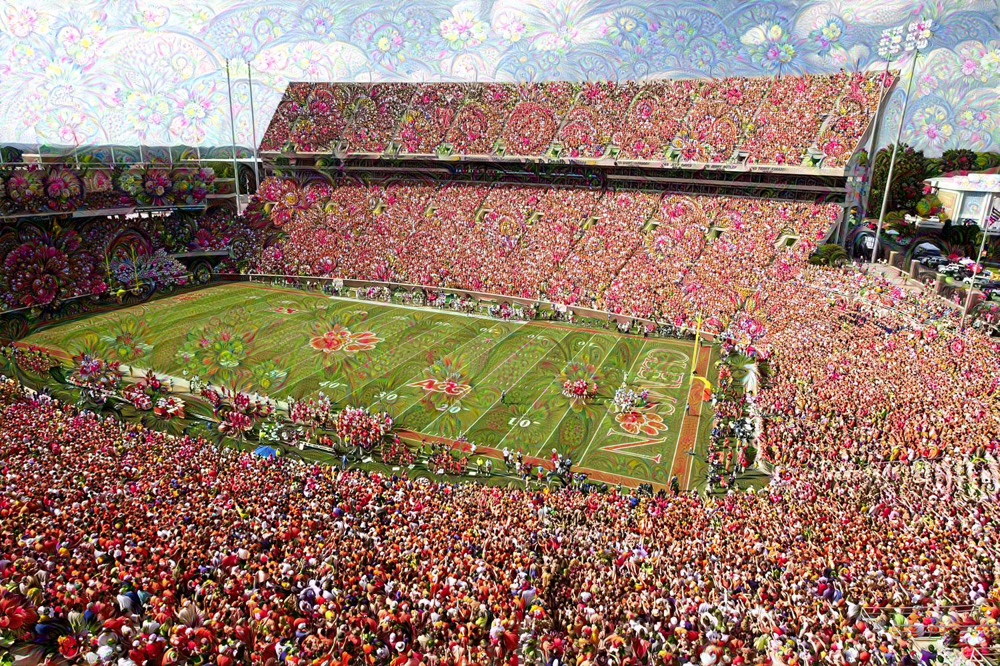

In [13]:
flowers = render_deepdream(T(layer)[:,:,:,139], img2)

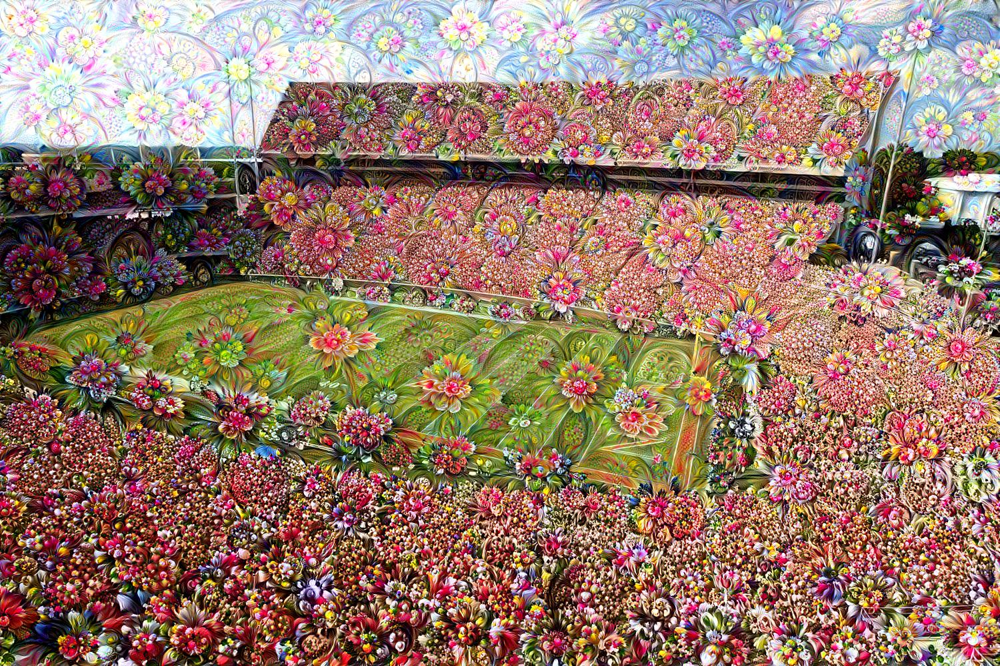

In [16]:
flowers = render_deepdream(T(layer)[:,:,:,139], flowers)

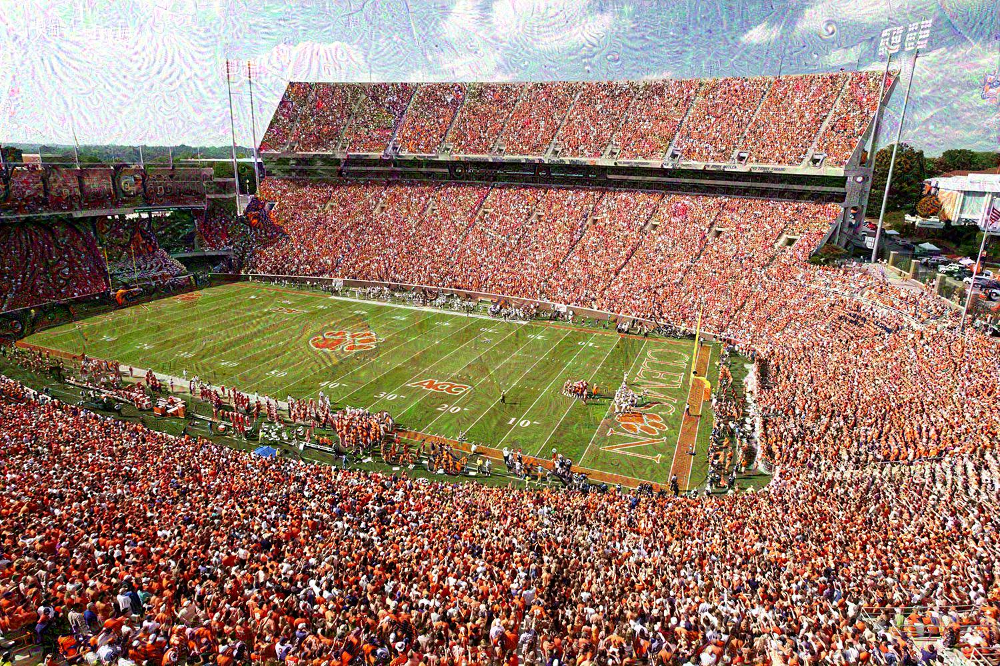

In [57]:
highlevel = render_deepdream(T("mixed5b")[:,:,:,115], img2)

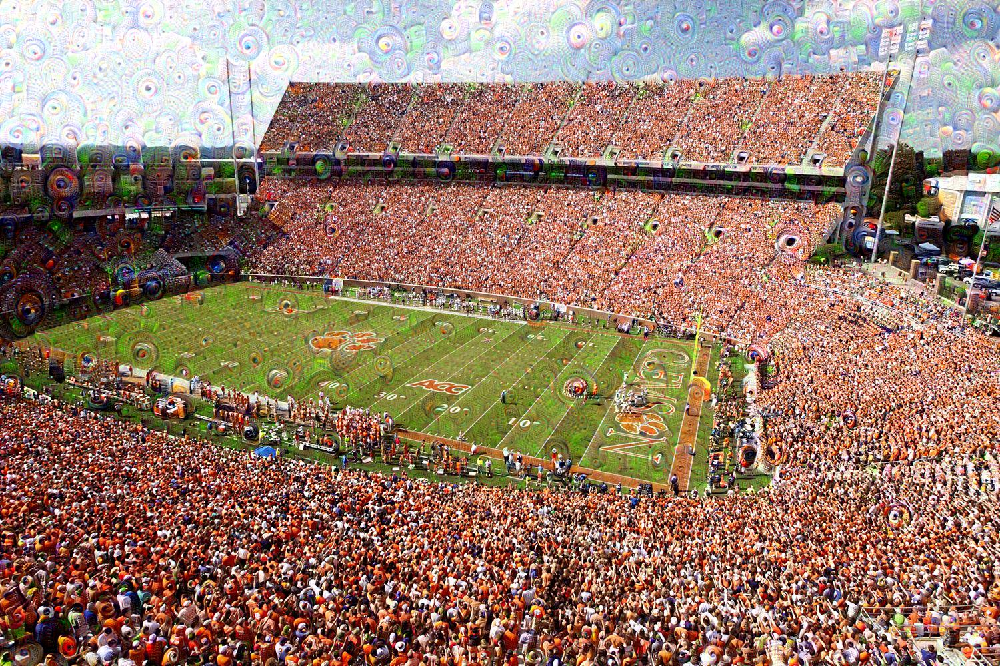

In [58]:
lower = render_deepdream(T("mixed4c")[:,:,:,115], img2)

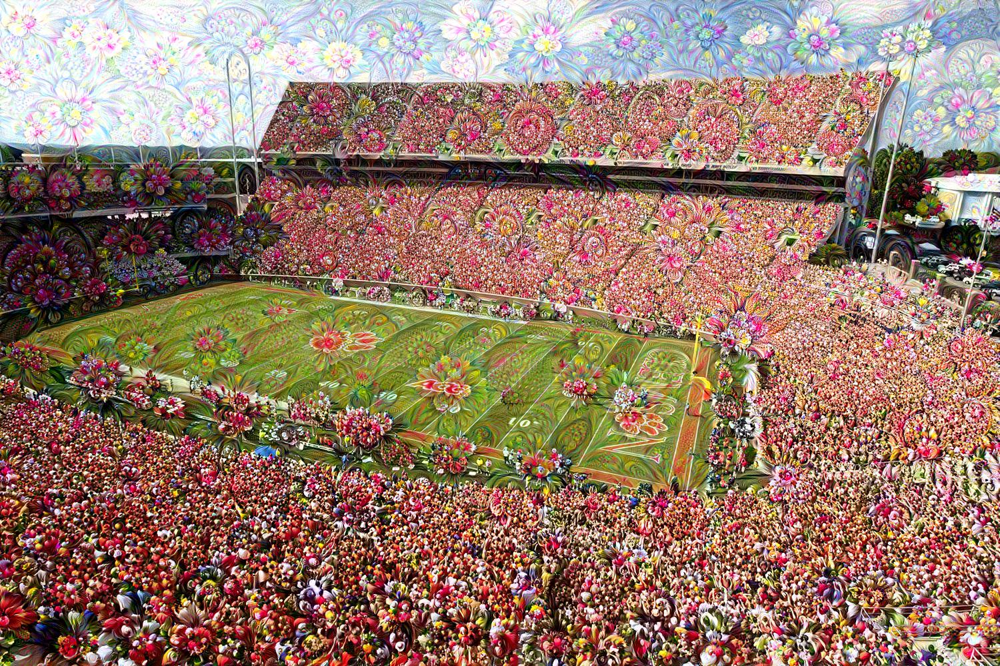

In [61]:
flowers = render_deepdream(T(layer)[:,:,:,139], flowers)

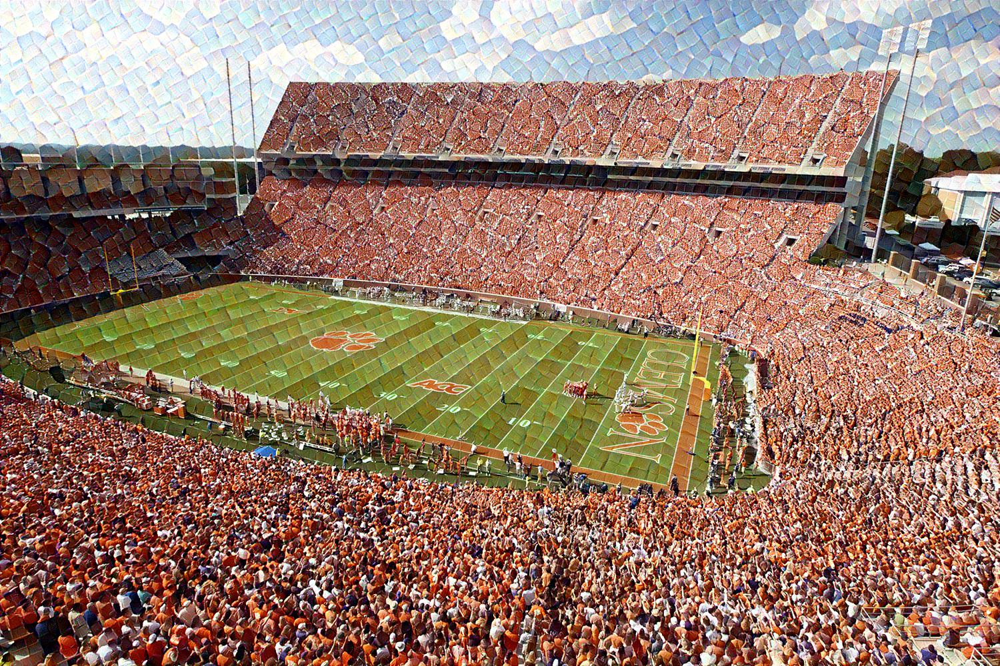

In [63]:
blocks = render_deepdream(T('mixed3b_1x1_pre_relu')[:,:,:,101], img2)

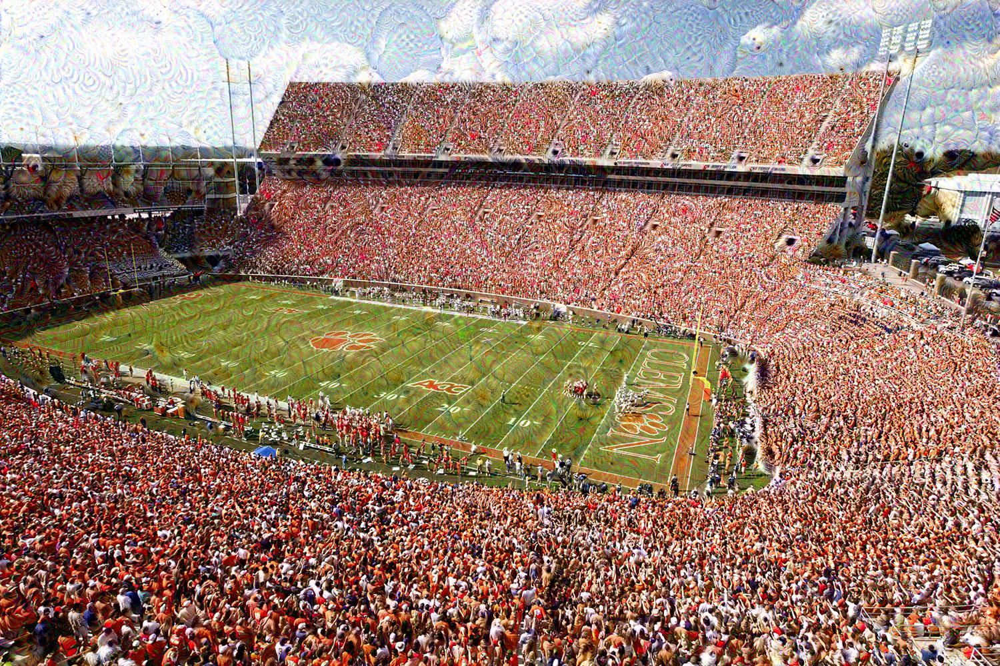

In [69]:
hl = render_deepdream(T(layer)[:,:,:,45], img2)

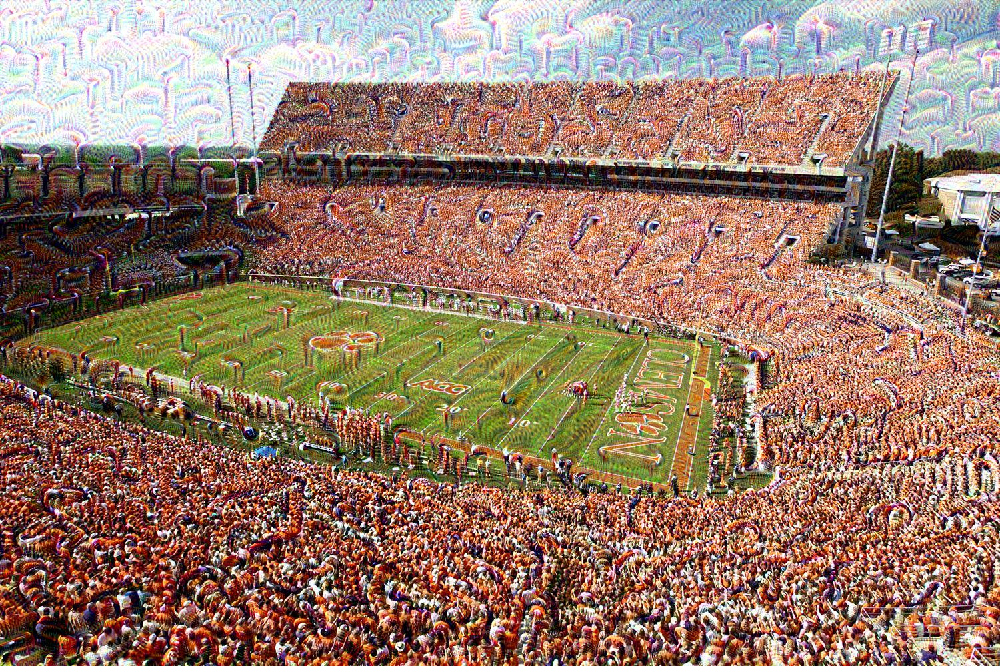

In [67]:
hl2 = render_deepdream(T(layer)[:,:,:,34], hl)

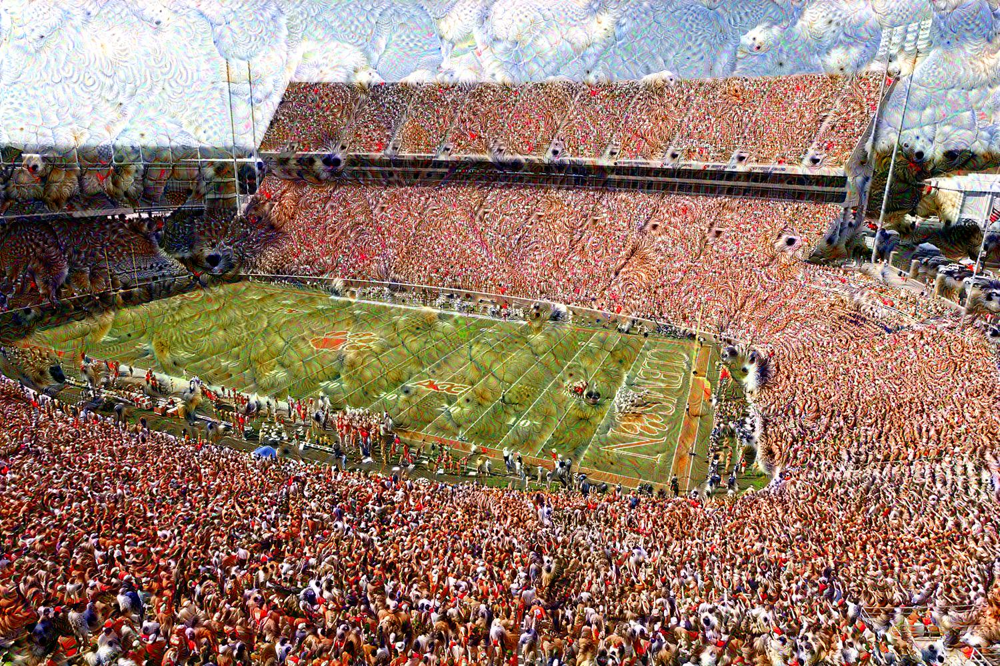

In [70]:
swirly = render_deepdream(T(layer)[:,:,:,45], hl)

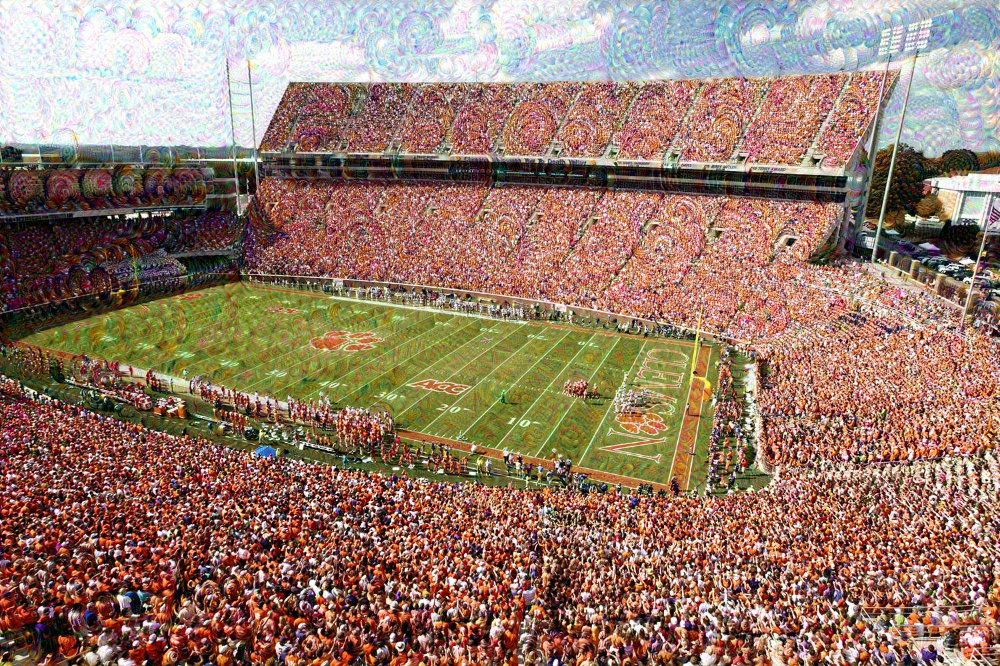

In [72]:
lvl_48 = render_deepdream(T(layer)[:,:,:,48], img2)



<a id="visualize"></a>
# Visualizing Different Layers

With this, we are going to start to develop an understanding of how these layers function. We can look at all of them by changing the laplacian rendering function so that it keeps the image displayed. 

In [25]:
def rendkeep(t_obj, img0=img_noise, visfunc=visstd,
                   iter_n=10, step=1.0, octave_n=3, octave_scale=1.4, lap_n=4):
    t_score = tf.reduce_mean(t_obj)
    t_grad = tf.gradients(t_score, t_input)[0]
    lap_norm_func = tffunc(np.float32)(partial(lap_normalize, scale_n=lap_n))

    img = img0.copy()
    for octave in range(octave_n):
        if octave>0:
            hw = np.float32(img.shape[:2])*octave_scale
            img = resize(img, np.int32(hw))
        for i in range(iter_n):
            g = calc_grad_tiled(img, t_grad)
            g = lap_norm_func(g)
            img += g*step
            print('.', end = ' ')
        print()
    showarray(visfunc(img))


## Layer Names

Using the list of layers, we can extract the names of the possible layers to observe.

In [28]:
layerNames = [l.replace("import/", "").replace("/conv","").encode().decode() for l in layers]
for (layer, i) in enumerate(layerNames):
    print(layer, i)
print("\n".join(layerNames))

conv2d0_pre_relu
conv2d1_pre_relu
conv2d2_pre_relu
mixed3a_1x1_pre_relu
mixed3a_3x3_bottleneck_pre_relu
mixed3a_3x3_pre_relu
mixed3a_5x5_bottleneck_pre_relu
mixed3a_5x5_pre_relu
mixed3a_pool_reduce_pre_relu
mixed3b_1x1_pre_relu
mixed3b_3x3_bottleneck_pre_relu
mixed3b_3x3_pre_relu
mixed3b_5x5_bottleneck_pre_relu
mixed3b_5x5_pre_relu
mixed3b_pool_reduce_pre_relu
mixed4a_1x1_pre_relu
mixed4a_3x3_bottleneck_pre_relu
mixed4a_3x3_pre_relu
mixed4a_5x5_bottleneck_pre_relu
mixed4a_5x5_pre_relu
mixed4a_pool_reduce_pre_relu
mixed4b_1x1_pre_relu
mixed4b_3x3_bottleneck_pre_relu
mixed4b_3x3_pre_relu
mixed4b_5x5_bottleneck_pre_relu
mixed4b_5x5_pre_relu
mixed4b_pool_reduce_pre_relu
mixed4c_1x1_pre_relu
mixed4c_3x3_bottleneck_pre_relu
mixed4c_3x3_pre_relu
mixed4c_5x5_bottleneck_pre_relu
mixed4c_5x5_pre_relu
mixed4c_pool_reduce_pre_relu
mixed4d_1x1_pre_relu
mixed4d_3x3_bottleneck_pre_relu
mixed4d_3x3_pre_relu
mixed4d_5x5_bottleneck_pre_relu
mixed4d_5x5_pre_relu
mixed4d_pool_reduce_pre_relu
mixed4e_1x1_p

In [31]:
# function for visualizing a particular layer in the network
def VisualizeLayer(layerName='mixed3b_1x1_pre_relu'):
    i = 0
    while True:
        try:
            # only one octave to be performant
            rendkeep(T(layerName)[:,:,:,i], octave_n=1)
            print("Optimized for " + str(i))
            i += 1
        except:
            break

### Higher Layer Visualization

This layer visualization shows how at the higher levels — only a few layers passed through — we have small repeated patterns for feature extraction.

. . . . . . . . . . 


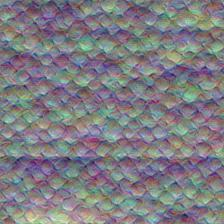

Optimized for 0
. . . . . . . . . . 


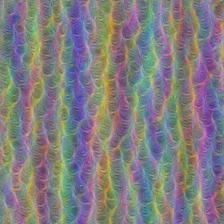

Optimized for 1
. . . . . . . . . . 


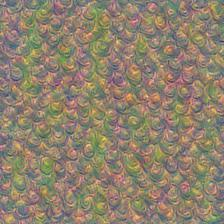

Optimized for 2
. . . . . . . . . . 


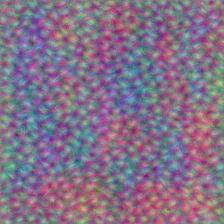

Optimized for 3
. . . . . . . . . . 


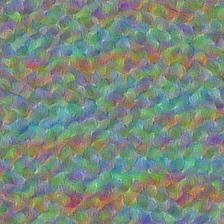

Optimized for 4
. . . . . . . . . . 


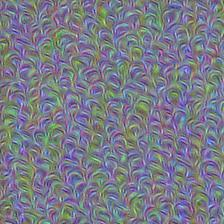

Optimized for 5
. . . . . . . . . . 


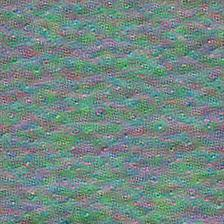

Optimized for 6
. . . . . . . . . . 


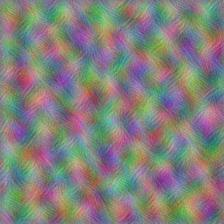

Optimized for 7
. . . . . . . . . . 


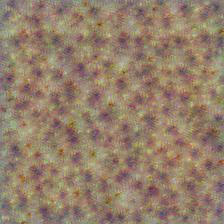

Optimized for 8
. . . . . . . . . . 


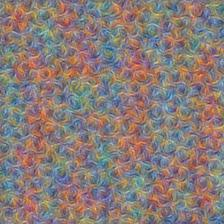

Optimized for 9
. . . . . . . . . . 


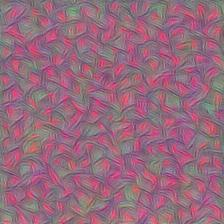

Optimized for 10
. . . . . . . . . . 


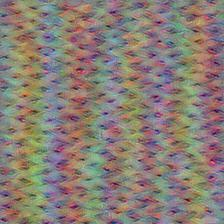

Optimized for 11
. . . . . . . . . . 


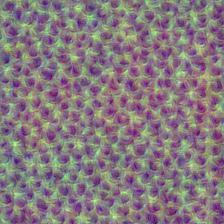

Optimized for 12
. . . . . . . . . . 


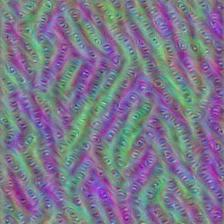

Optimized for 13
. . . . . . . . . . 


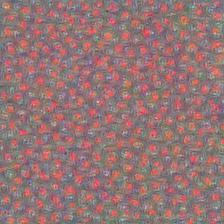

Optimized for 14
. . . . . . . . . . 


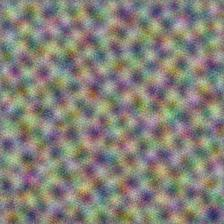

Optimized for 15
. . . . . . . . . . 


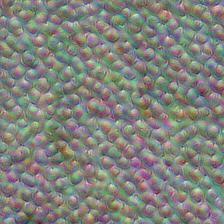

Optimized for 16
. . . . . . . . . . 


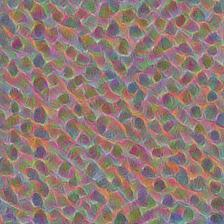

Optimized for 17
. . . . . . . . . . 


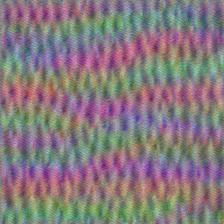

Optimized for 18
. . . . . . . . . . 


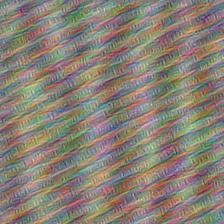

Optimized for 19
. . . . . . . . . . 


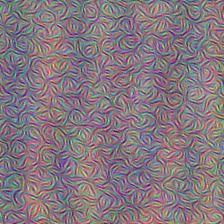

Optimized for 20
. . . . . . . . . . 


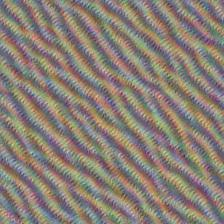

Optimized for 21
. . . . . . . . . . 


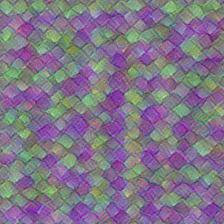

Optimized for 22
. . . . . . . . . . 


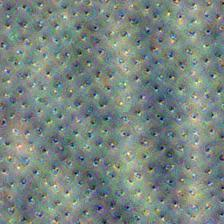

Optimized for 23
. . . . . . . . . . 


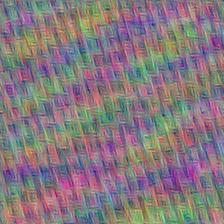

Optimized for 24
. . . . . . . . . . 


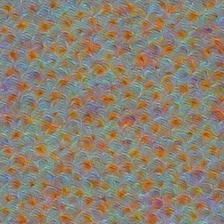

Optimized for 25
. . . . . . . . . . 


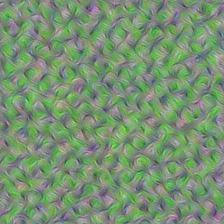

Optimized for 26
. . . . . . . . . . 


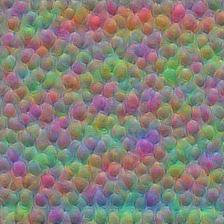

Optimized for 27
. . . . . . . . . . 


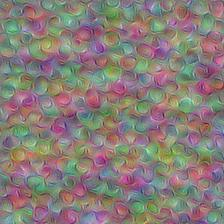

Optimized for 28
. . . . . . . . . . 


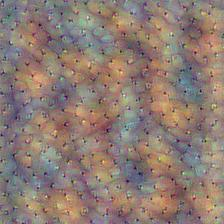

Optimized for 29
. . . . . . . . . . 


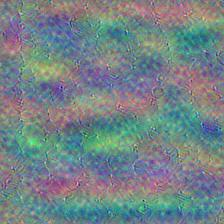

Optimized for 30
. . . . . . . . . . 


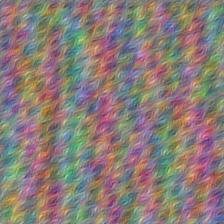

Optimized for 31
. . . . . . . . . . 


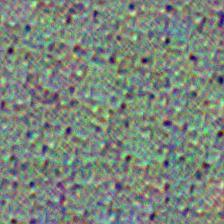

Optimized for 32
. . . . . . . . . . 


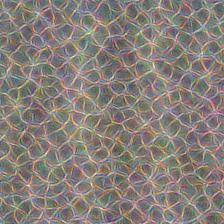

Optimized for 33
. . . . . . . . . . 


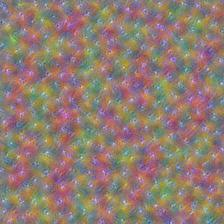

Optimized for 34
. . . . . . . . . . 


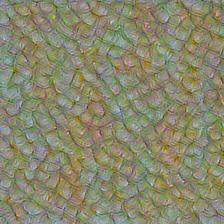

Optimized for 35
. . . . . . . . . . 


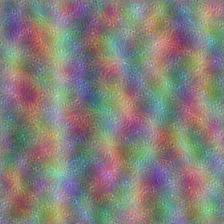

Optimized for 36
. . . . . . . . . . 


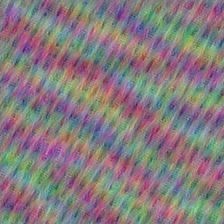

Optimized for 37
. . . . . . . . . . 


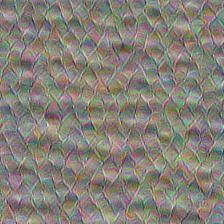

Optimized for 38
. . . . . . . . . . 


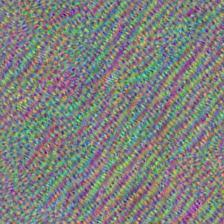

Optimized for 39
. . . . . . . . . . 


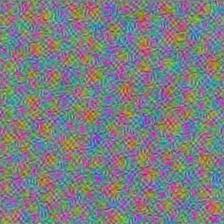

Optimized for 40
. . . . . . . . . . 


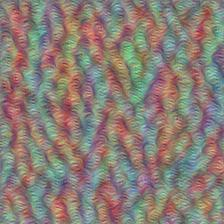

Optimized for 41
. . . . . . . . . . 


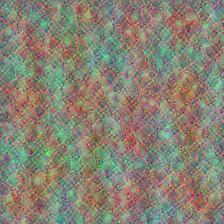

Optimized for 42
. . . . . . . . . . 


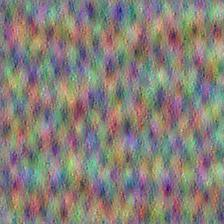

Optimized for 43
. . . . . . . . . . 


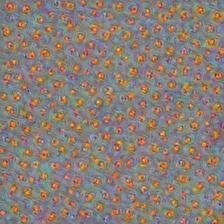

Optimized for 44
. . . . . . . . . . 


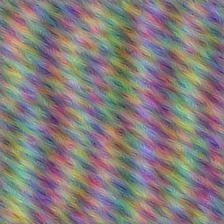

Optimized for 45
. . . . . . . . . . 


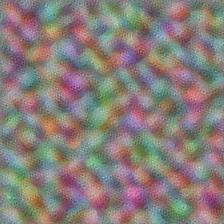

Optimized for 46
. . . . . . . . . . 


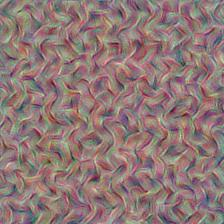

Optimized for 47
. . . . . . . . . . 


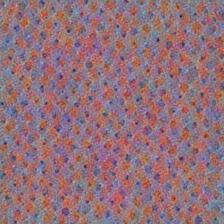

Optimized for 48
. . . . . . . . . . 


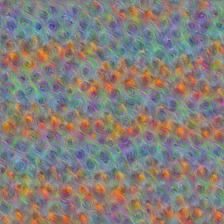

Optimized for 49
. . . . . . . . . . 


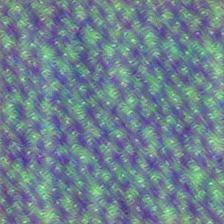

Optimized for 50
. . . . . . . . . . 


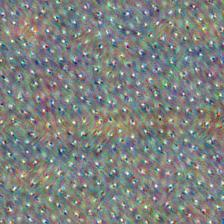

Optimized for 51
. . . . . . . . . . 


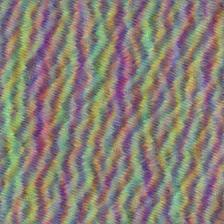

Optimized for 52
. . . . . . . . . . 


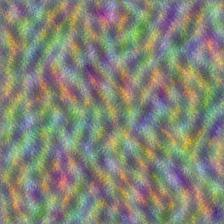

Optimized for 53
. . . . . . . . . . 


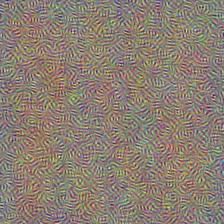

Optimized for 54
. . . . . . . . . . 


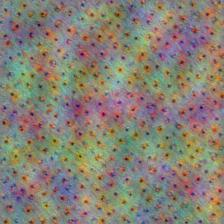

Optimized for 55
. . . . . . . . . . 


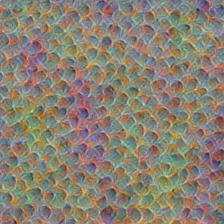

Optimized for 56
. . . . . . . . . . 


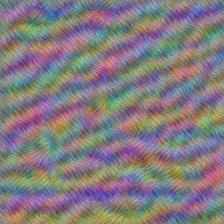

Optimized for 57
. . . . . . . . . . 


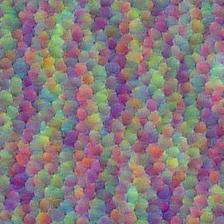

Optimized for 58
. . . . . . . . . . 


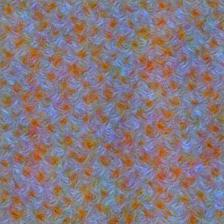

Optimized for 59
. . . . . . . . . . 


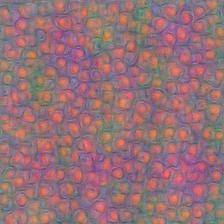

Optimized for 60
. . . . . . . . . . 


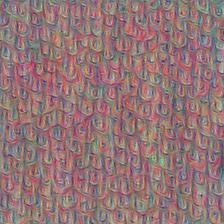

Optimized for 61
. . . . . . . . . . 


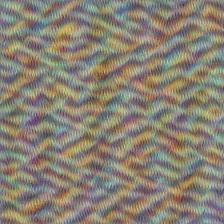

Optimized for 62
. . . . . . . . . . 


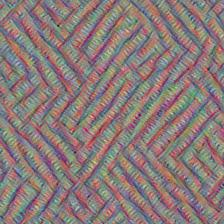

Optimized for 63
. . . . . . . . . . 


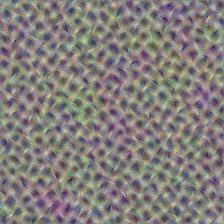

Optimized for 64
. . . . . . . . . . 


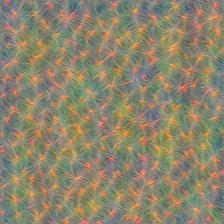

Optimized for 65
. . . . . . . . . . 


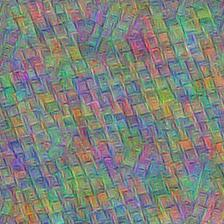

Optimized for 66
. . . . . . . . . . 


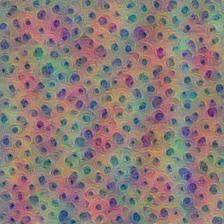

Optimized for 67
. . . . . . . . . . 


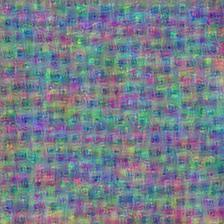

Optimized for 68
. . . . . . . . . . 


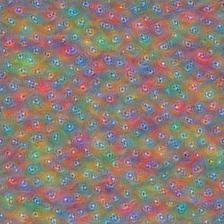

Optimized for 69
. . . . . . . . . . 


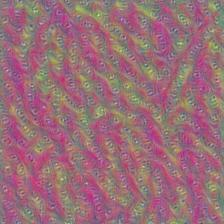

Optimized for 70
. . . . . . . . . . 


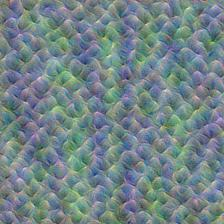

Optimized for 71
. . . . . . . . . . 


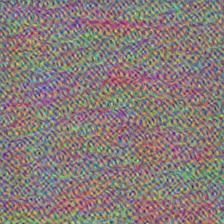

Optimized for 72
. . . . . . . . . . 


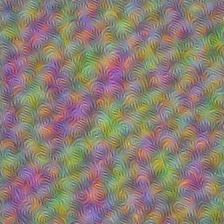

Optimized for 73
. . . . . . . . . . 


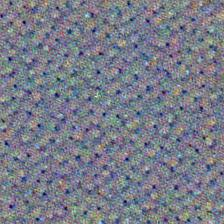

Optimized for 74
. . . . . . . . . . 


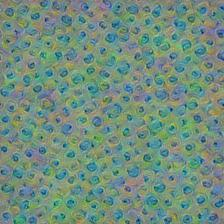

Optimized for 75
. . . . . . . . . . 


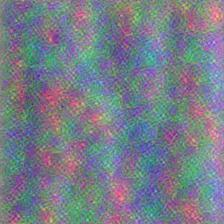

Optimized for 76
. . . . . . . . . . 


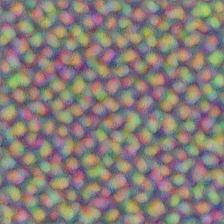

Optimized for 77
. . . . . . . . . . 


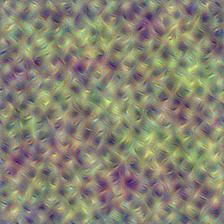

Optimized for 78
. . . . . . . . . . 


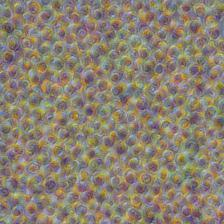

Optimized for 79
. . . . . . . . . . 


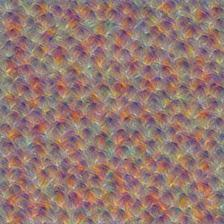

Optimized for 80
. . . . . . . . . . 


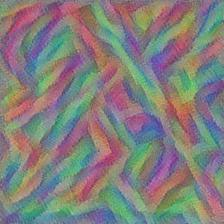

Optimized for 81
. . . . . . . . . . 


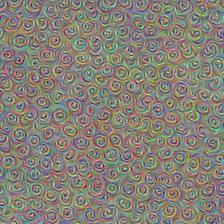

Optimized for 82
. . . . . . . . . . 


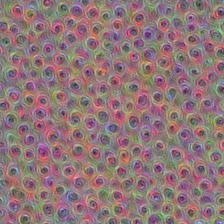

Optimized for 83
. . . . . . . . . . 


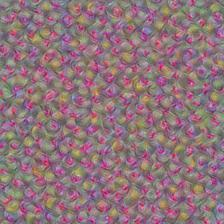

Optimized for 84
. . . . . . . . . . 


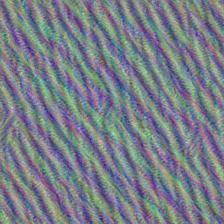

Optimized for 85
. . . . . . . . . . 


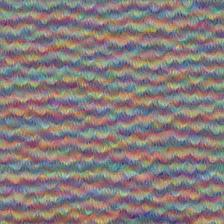

Optimized for 86
. . . . . . . . . . 


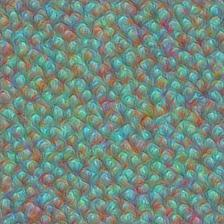

Optimized for 87
. . . . . . . . . . 


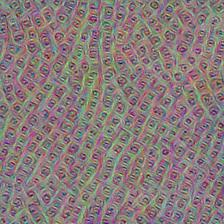

Optimized for 88
. . . . . . . . . . 


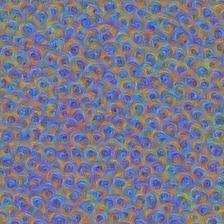

Optimized for 89
. . . . . . . . . . 


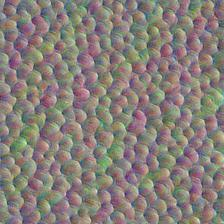

Optimized for 90
. . . . . . . . . . 


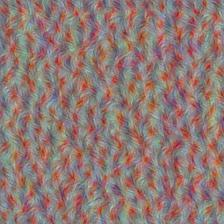

Optimized for 91
. . . . . . . . . . 


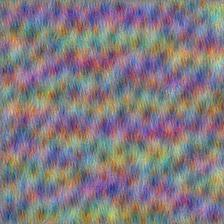

Optimized for 92
. . . . . . . . . . 


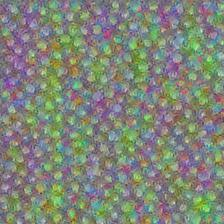

Optimized for 93
. . . . . . . . . . 


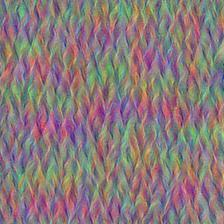

Optimized for 94
. . . . . . . . . . 


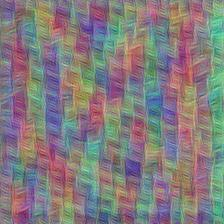

Optimized for 95
. . . . . . . . . . 


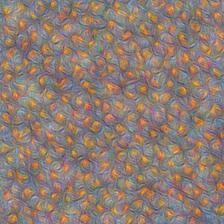

Optimized for 96
. . . . . . . . . . 


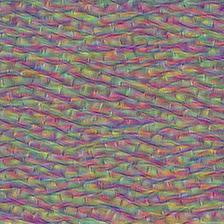

Optimized for 97
. . . . . . . . . . 


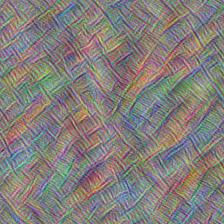

Optimized for 98
. . . . . . . . . . 


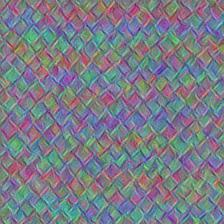

Optimized for 99
. . . . . . . . . . 


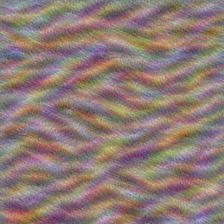

Optimized for 100
. . . . . . . . . . 


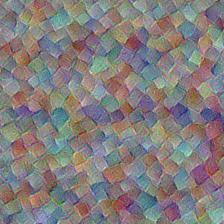

Optimized for 101
. . . . . . . . . . 


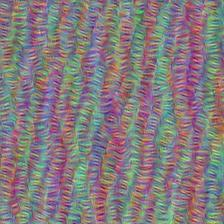

Optimized for 102
. . . . . . . . . . 


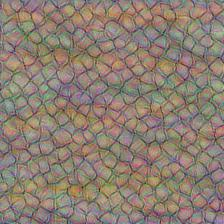

Optimized for 103
. . . . . . . . . . 


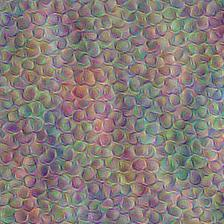

Optimized for 104
. . . . . . . . . . 


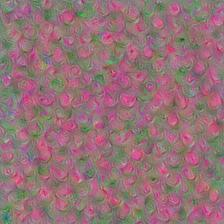

Optimized for 105
. . . . . . . . . . 


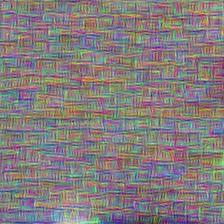

Optimized for 106
. . . . . . . . . . 


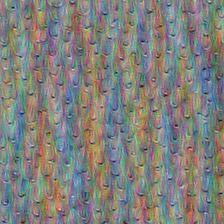

Optimized for 107
. . . . . . . . . . 


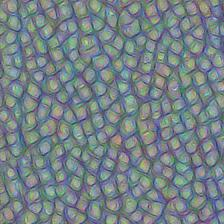

Optimized for 108
. . . . . . . . . . 


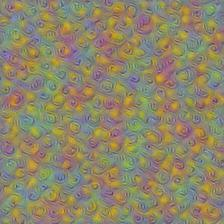

Optimized for 109
. . . . . . . . . . 


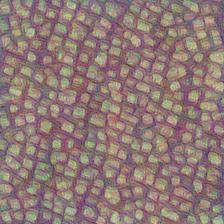

Optimized for 110
. . . . . . . . . . 


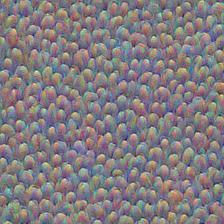

Optimized for 111
. . . . . . . . . . 


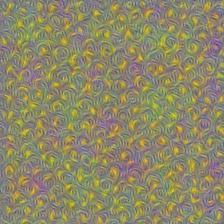

Optimized for 112
. . . . . . . . . . 


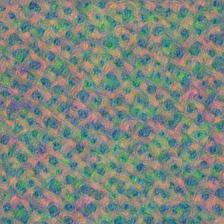

Optimized for 113
. . . . . . . . . . 


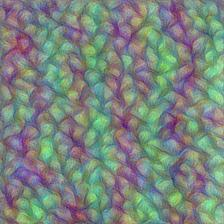

Optimized for 114
. . . . . . . . . . 


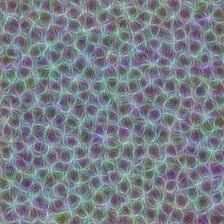

Optimized for 115
. . . . . . . . . . 


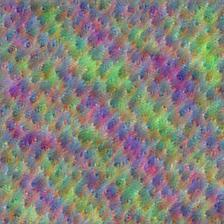

Optimized for 116
. . . . . . . . . . 


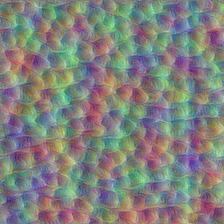

Optimized for 117
. . . . . . . . . . 


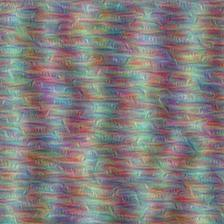

Optimized for 118
. . . . . . . . . . 


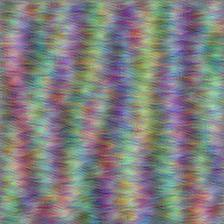

Optimized for 119
. . . . . . . . . . 


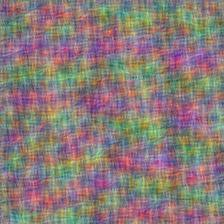

Optimized for 120
. . . . . . . . . . 


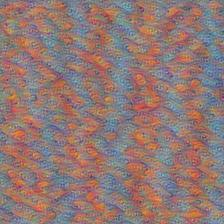

Optimized for 121
. . . . . . . . . . 


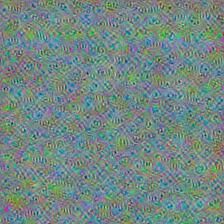

Optimized for 122
. . . . . . . . . . 


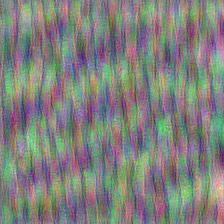

Optimized for 123
. . . . . . . . . . 


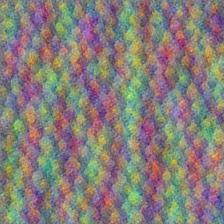

Optimized for 124
. . . . . . . . . . 


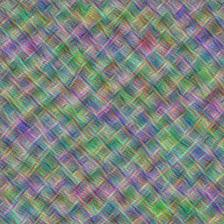

Optimized for 125
. . . . . . . . . . 


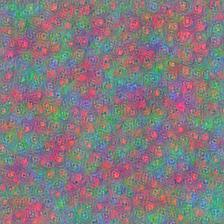

Optimized for 126
. . . . . . . . . . 


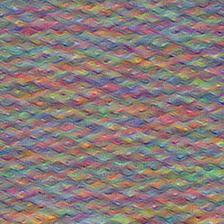

Optimized for 127


In [32]:
VisualizeLayer('mixed3b_1x1_pre_relu')

### Convolution Layer

Within the convolution layer, we are looking at base level transformations of importance.

The process of convolution, as applied to images is portrayed well in this gif.

![](convolution.gif)

It takes a combination of the features of other layers to show what may actually be import things. It often takes an image

![](max_pooling.webp)

[image source](http://cv-tricks.com/image-segmentation/transpose-convolution-in-tensorflow/)

Max Pooling is a common convolutional technqiue. It takes the maximum value of a particular cluster of neurons at the prior level. 



### Parallels with biology

Animal visual cortex system

![](hubel-and-wiesel.jpg)

[image source](http://knowingneurons.com/2014/10/29/hubel-and-wiesel-the-neural-basis-of-visual-perception/)

The first layers with visual systems work towards extracting very low level features (particulary, bars and lines). 

The network at this level is most activated when looking at particularly angled lines. We also start to extract textures as we go up in levels. 

. . . . . . . . . . 


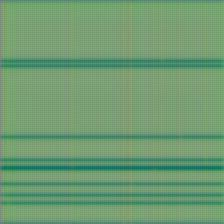

Optimized for 0
. . . . . . . . . . 


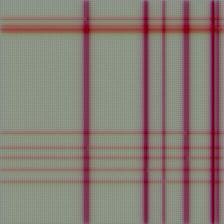

Optimized for 1
. . . . . . . . . . 


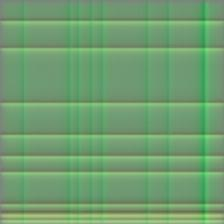

Optimized for 2
. . . . . . . . . . 


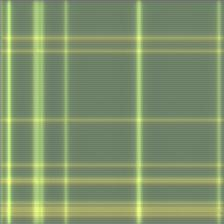

Optimized for 3
. . . . . . . . . . 


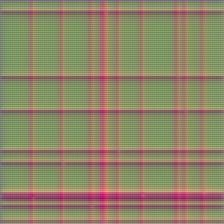

Optimized for 4
. . . . . . . . . . 


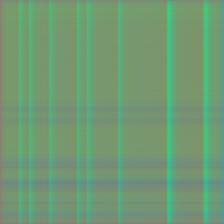

Optimized for 5
. . . . . . . . . . 


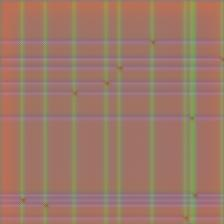

Optimized for 6
. . . . . . . . . . 


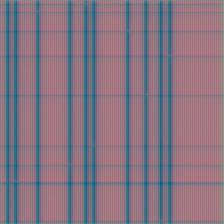

Optimized for 7
. . . . . . . . . . 


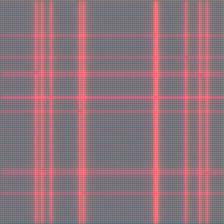

Optimized for 8
. . . . . . . . . . 


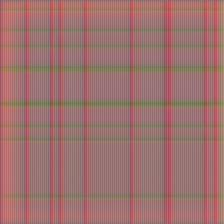

Optimized for 9
. . . . . . . . . . 


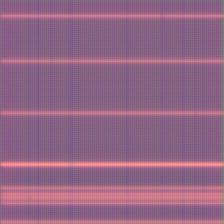

Optimized for 10
. . . . . . . . . . 


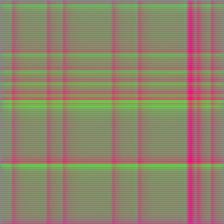

Optimized for 11
. . . . . . . . . . 


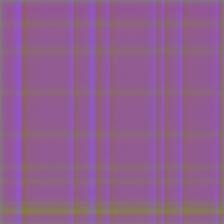

Optimized for 12
. . . . . . . . . . 


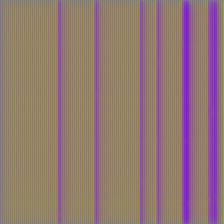

Optimized for 13
. . . . . . . . . . 


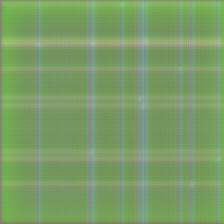

Optimized for 14
. . . . . . . . . . 


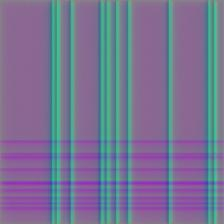

Optimized for 15
. . . . . . . . . . 


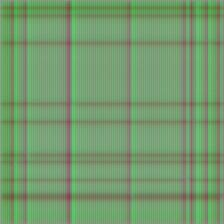

Optimized for 16
. . . . . . . . . . 


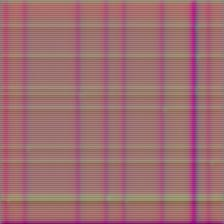

Optimized for 17
. . . . . . . . . . 


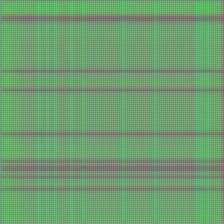

Optimized for 18
. . . . . . . . . . 


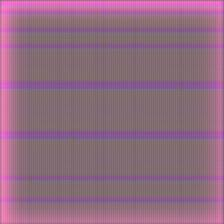

Optimized for 19
. . . . . . . . . . 


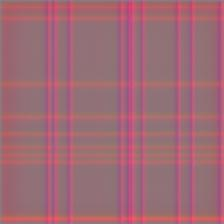

Optimized for 20
. . . . . . . . . . 


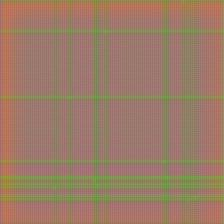

Optimized for 21
. . . . . . . . . . 


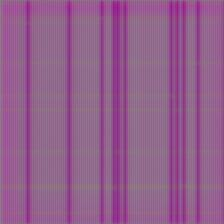

Optimized for 22
. . . . . . . . . . 


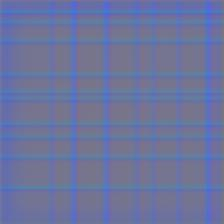

Optimized for 23
. . . . . . . . . . 


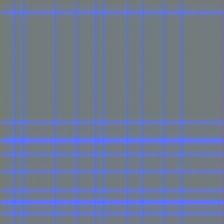

Optimized for 24
. . . . . . . . . . 


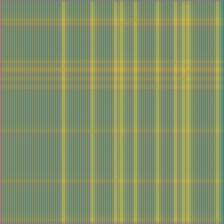

Optimized for 25
. . . . . . . . . . 


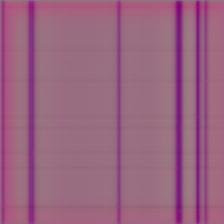

Optimized for 26
. . . . . . . . . . 


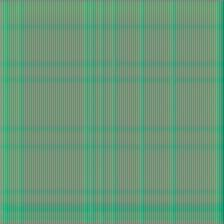

Optimized for 27
. . . . . . . . . . 


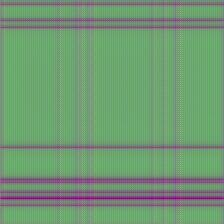

Optimized for 28
. . . . . . . . . . 


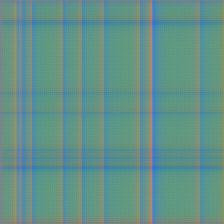

Optimized for 29
. . . . . . . . . . 


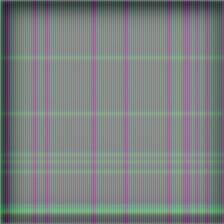

Optimized for 30
. . . . . . . . . . 


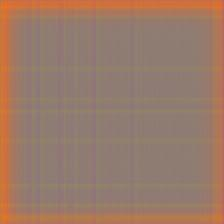

Optimized for 31
. . . . . . . . . . 


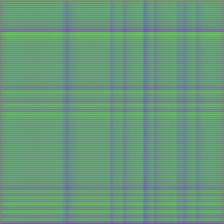

Optimized for 32
. . . . . . . . . . 


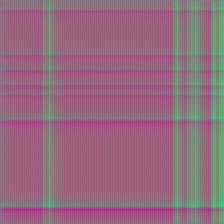

Optimized for 33
. . . . . . . . . . 


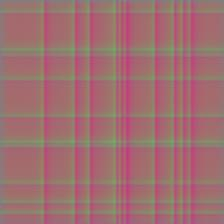

Optimized for 34
. . . . . . . . . . 


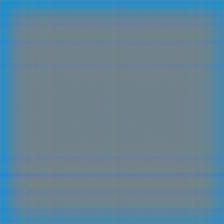

Optimized for 35
. . . . . . . . . . 


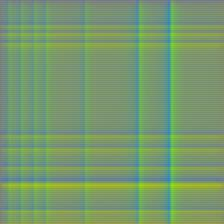

Optimized for 36
. . . . . . . . . . 


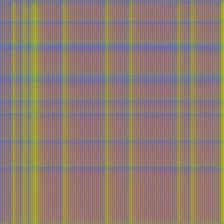

Optimized for 37
. . . . . . . . . . 


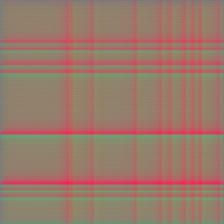

Optimized for 38
. . . . . . . . . . 


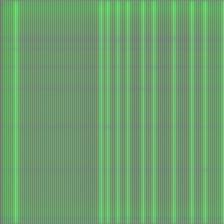

Optimized for 39
. . . . . . . . . . 


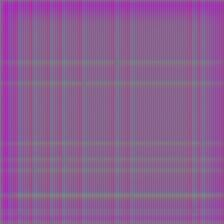

Optimized for 40
. . . . . . . . . . 


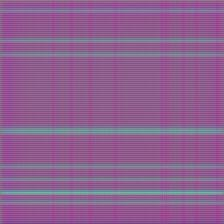

Optimized for 41
. . . . . . . . . . 


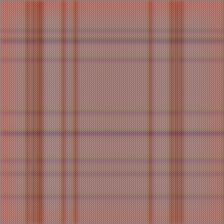

Optimized for 42
. . . . . . . . . . 


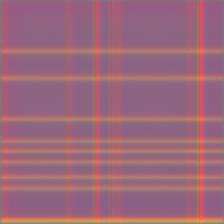

Optimized for 43
. . . . . . . . . . 


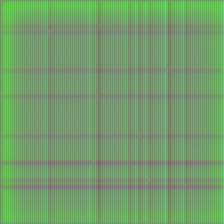

Optimized for 44
. . . . . . . . . . 


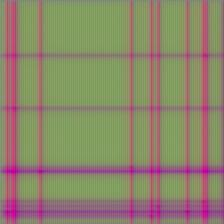

Optimized for 45
. . . . . . . . . . 


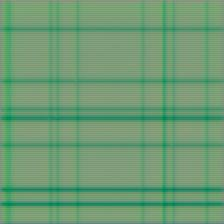

Optimized for 46
. . . . . . . . . . 


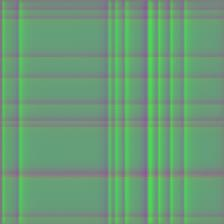

Optimized for 47
. . . . . . . . . . 


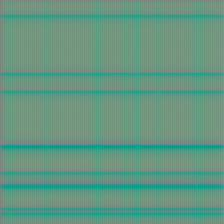

Optimized for 48
. . . . . . . . . . 


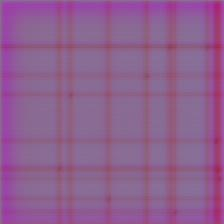

Optimized for 49
. . . . . . . . . . 


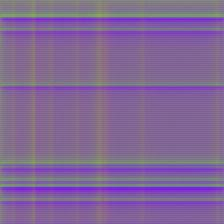

Optimized for 50
. . . . . . . . . . 


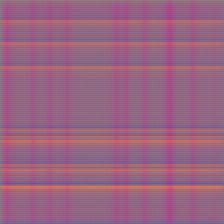

Optimized for 51
. . . . . . . . . . 


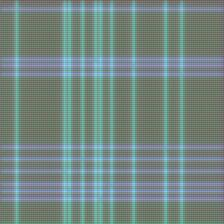

Optimized for 52
. . . . . . . . . . 


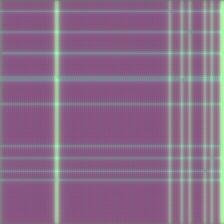

Optimized for 53
. . . . . . . . . . 


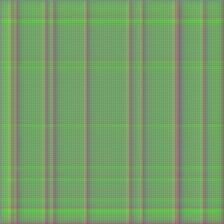

Optimized for 54
. . . . . . . . . . 


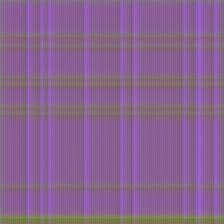

Optimized for 55
. . . . . . . . . . 


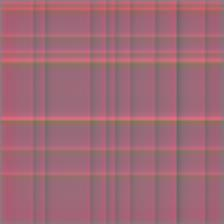

Optimized for 56
. . . . . . . . . . 


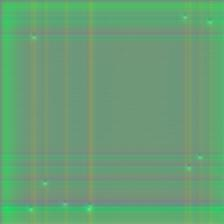

Optimized for 57
. . . . . . . . . . 


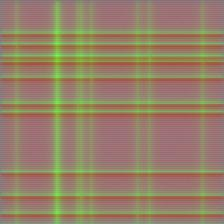

Optimized for 58
. . . . . . . . . . 


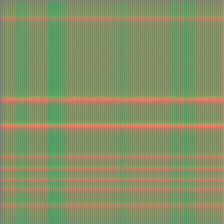

Optimized for 59
. . . . . . . . . . 


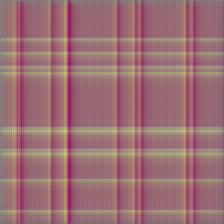

Optimized for 60
. . . . . . . . . . 


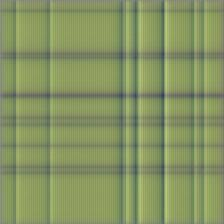

Optimized for 61
. . . . . . . . . . 


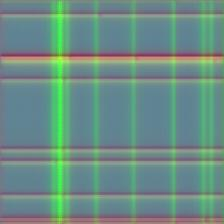

Optimized for 62
. . . . . . . . . . 


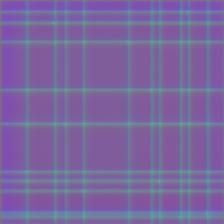

Optimized for 63


In [33]:
VisualizeLayer('conv2d0_pre_relu')

. . . . . . . . . . 


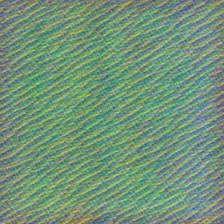

Optimized for 0
. . . . . . . . . . 


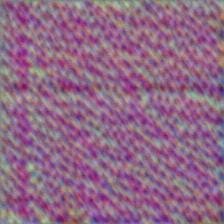

Optimized for 1
. . . . . . . . . . 


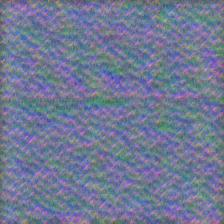

Optimized for 2
. . . . . . . . . . 


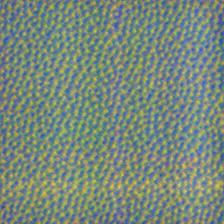

Optimized for 3
. . . . . . . . . . 


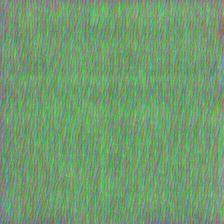

Optimized for 4
. . . . . . . . . . 


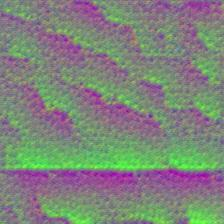

Optimized for 5
. . . . . . . . . . 


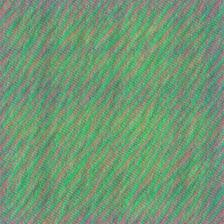

Optimized for 6
. . . . . . . . . . 


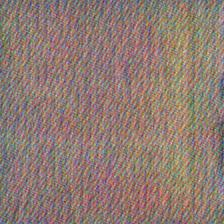

Optimized for 7
. . . . . . . . . . 


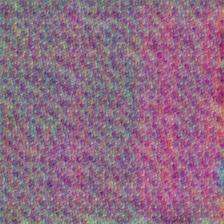

Optimized for 8
. . . . . . . . . . 


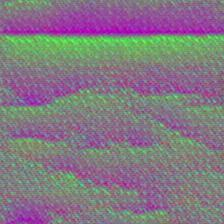

Optimized for 9
. . . . . . . . . . 


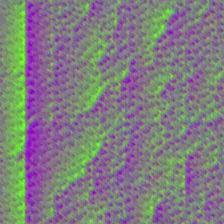

Optimized for 10
. . . . . . . . . . 


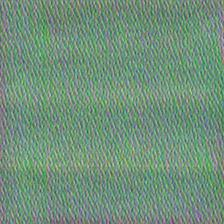

Optimized for 11
. . . . . . . . . . 


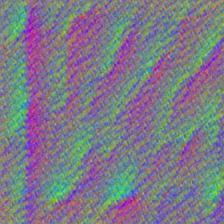

Optimized for 12
. . . . . . . . . . 


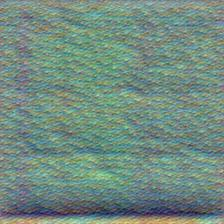

Optimized for 13
. . . . . . . . . . 


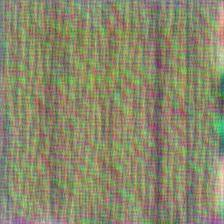

Optimized for 14
. . . . . . . . . . 


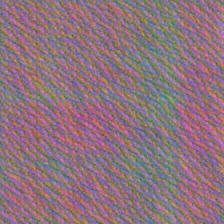

Optimized for 15
. . . . . . . . . . 


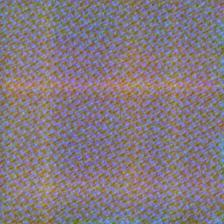

Optimized for 16
. . . . . . . . . . 


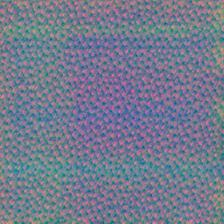

Optimized for 17
. . . . . . . . . . 


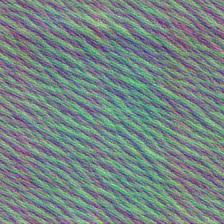

Optimized for 18
. . . . . . . . . . 


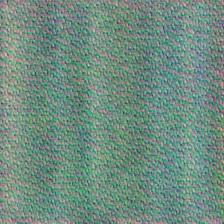

Optimized for 19
. . . . . . . . . . 


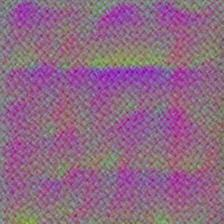

Optimized for 20
. . . . . . . . . . 


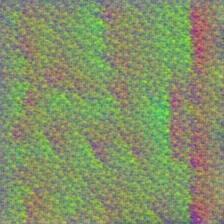

Optimized for 21
. . . . . . . . . . 


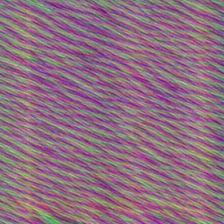

Optimized for 22
. . . . . . . . . . 


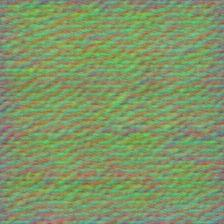

Optimized for 23
. . . . . . . . . . 


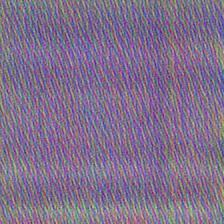

Optimized for 24
. . . . . . . . . . 


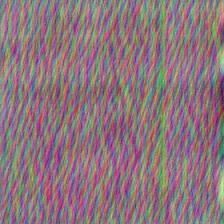

Optimized for 25
. . . . . . . . . . 


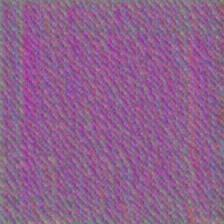

Optimized for 26
. . . . . . . . . . 


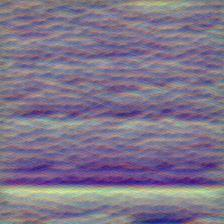

Optimized for 27
. . . . . . . . . . 


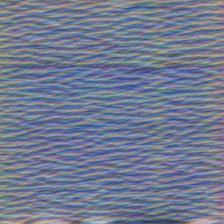

Optimized for 28
. . . . . . . . . . 


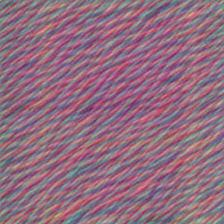

Optimized for 29
. . . . . . . . . . 


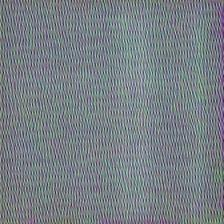

Optimized for 30
. . . . . . . . . . 


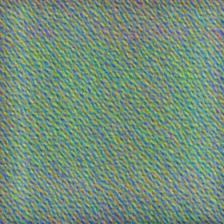

Optimized for 31
. . . . . . . . . . 


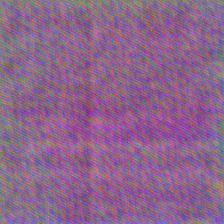

Optimized for 32
. . . . . . . . . . 


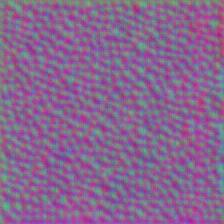

Optimized for 33
. . . . . . . . . . 


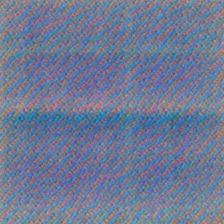

Optimized for 34
. . . . . . . . . . 


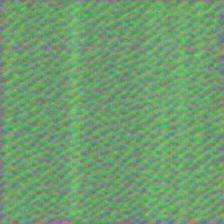

Optimized for 35
. . . . . . . . . . 


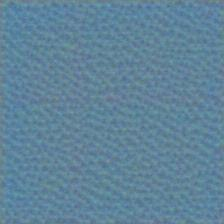

Optimized for 36
. . . . . . . . . . 


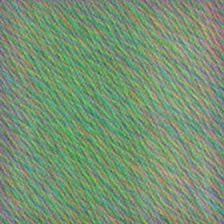

Optimized for 37
. . . . . . . . . . 


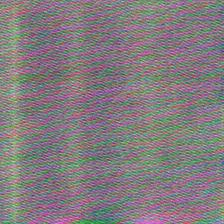

Optimized for 38
. . . . . . . . . . 


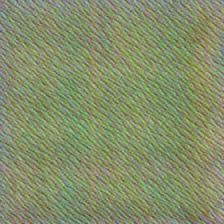

Optimized for 39
. . . . . . . . . . 


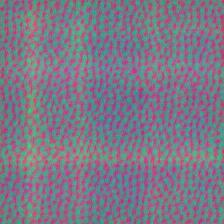

Optimized for 40
. . . . . . . . . . 


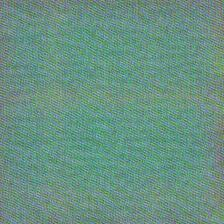

Optimized for 41
. . . . . . . . . . 


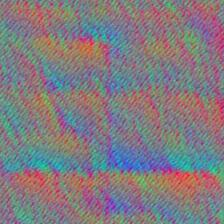

Optimized for 42
. . . . . . . . . . 


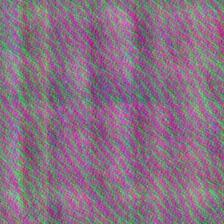

Optimized for 43
. . . . . . . . . . 


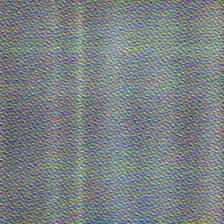

Optimized for 44
. . . . . . . . . . 


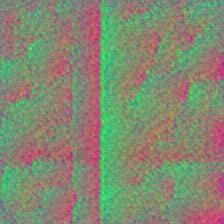

Optimized for 45
. . . . . . . . . . 


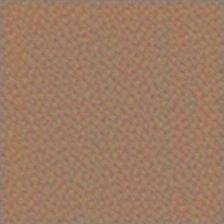

Optimized for 46
. . . . . . . . . . 


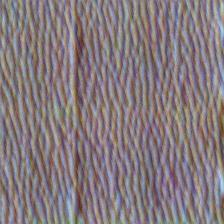

Optimized for 47
. . . . . . . . . . 


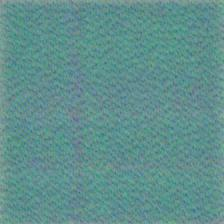

Optimized for 48
. . . . . . . . . . 


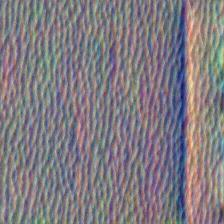

Optimized for 49
. . . . . . . . . . 


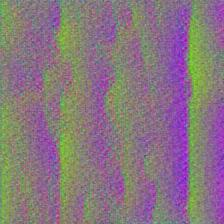

Optimized for 50
. . . . . . . . . . 


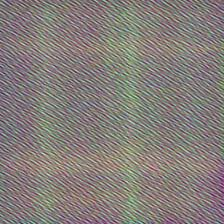

Optimized for 51
. . . . . . . . . . 


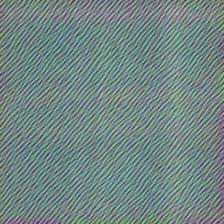

Optimized for 52
. . . . . . . . . . 


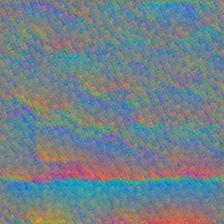

Optimized for 53
. . . . . . . . . . 


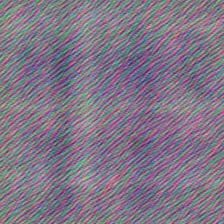

Optimized for 54
. . . . . . . . . . 


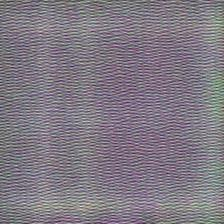

Optimized for 55
. . . . . . . . . . 


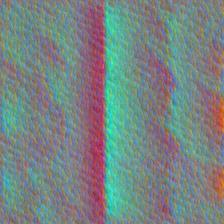

Optimized for 56
. . . . . . . . . . 


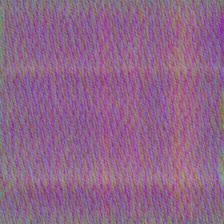

Optimized for 57
. . . . . . . . . . 


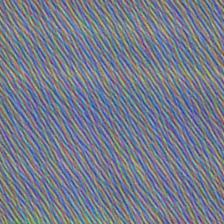

Optimized for 58
. . . . . . . . . . 


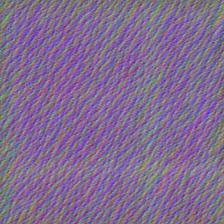

Optimized for 59
. . . . . . . . . . 


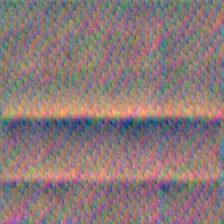

Optimized for 60
. . . . . . . . . . 


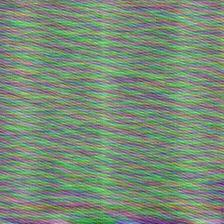

Optimized for 61
. . . . . . . . . . 


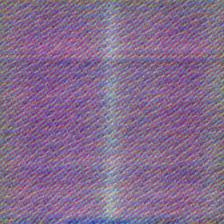

Optimized for 62
. . . . . . . . . . 


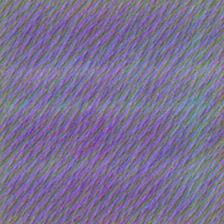

Optimized for 63


In [34]:
VisualizeLayer('conv2d1_pre_relu')

. . . . . . . . . . 


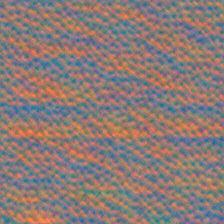

Optimized for 0
. . . . . . . . . . 


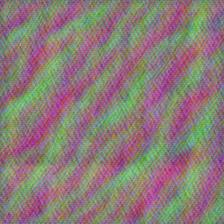

Optimized for 1
. . . . . . . . . . 


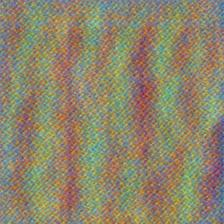

Optimized for 2
. . . . . . . . . . 


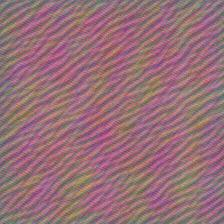

Optimized for 3
. . . . . . . . . . 


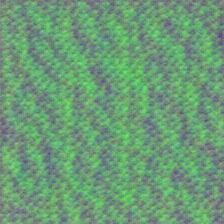

Optimized for 4
. . . . . . . . . . 


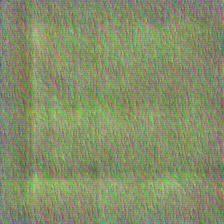

Optimized for 5
. . . . . . . . . . 


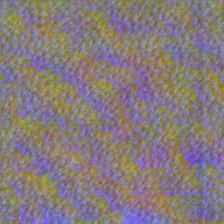

Optimized for 6
. . . . . . . . . . 


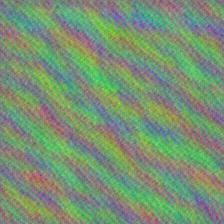

Optimized for 7
. . . . . . . . . . 


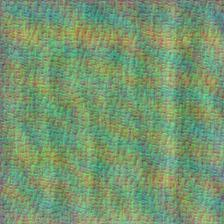

Optimized for 8
. . . . . . . . . . 


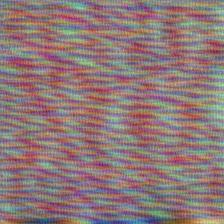

Optimized for 9
. . . . . . . . . . 


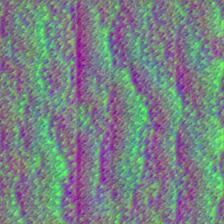

Optimized for 10
. . . . . . . . . . 


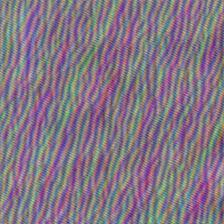

Optimized for 11
. . . . . . . . . . 


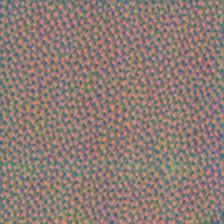

Optimized for 12
. . . . . . . . . . 


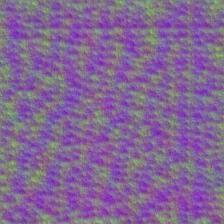

Optimized for 13
. . . . . . . . . . 


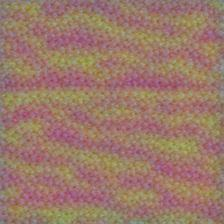

Optimized for 14
. . . . . . . . . . 


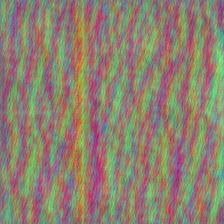

Optimized for 15
. . . . . . . . . . 


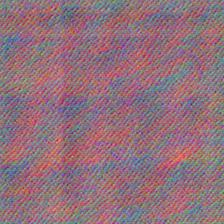

Optimized for 16
. . . . . . . . . . 


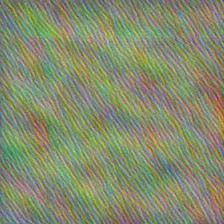

Optimized for 17
. . . . . . . . . . 


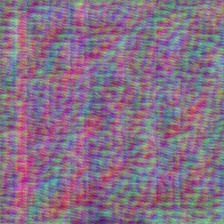

Optimized for 18
. . . . . . . . . . 


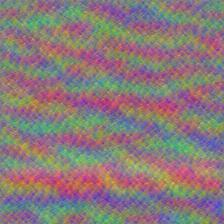

Optimized for 19
. . . . . . . . . . 


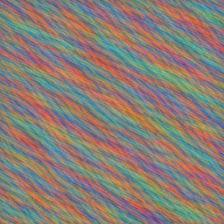

Optimized for 20
. . . . . . . . . . 


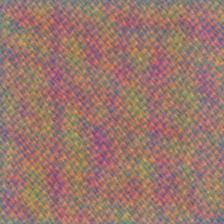

Optimized for 21
. . . . . . . . . . 


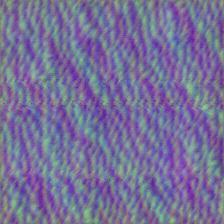

Optimized for 22
. . . . . . . . . . 


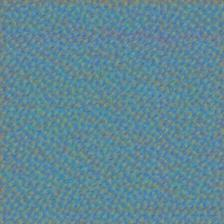

Optimized for 23
. . . . . . . . . . 


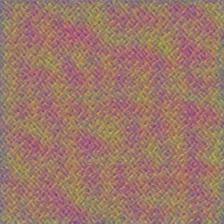

Optimized for 24
. . . . . . . . . . 


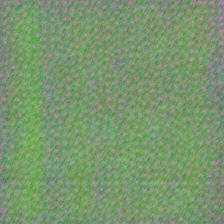

Optimized for 25
. . . . . . . . . . 


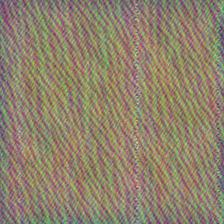

Optimized for 26
. . . . . . . . . . 


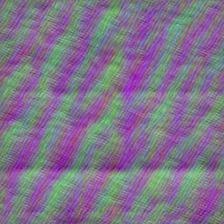

Optimized for 27
. . . . . . . . . . 


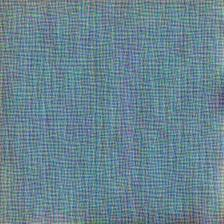

Optimized for 28
. . . . . . . . . . 


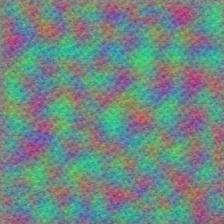

Optimized for 29
. . . . . . . . . . 


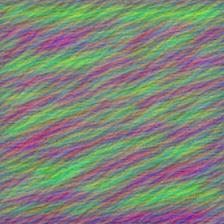

Optimized for 30
. . . . . . . . . . 


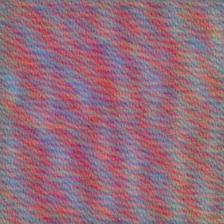

Optimized for 31
. . . . . . . . . . 


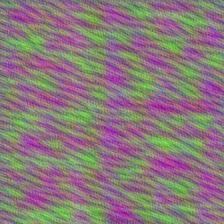

Optimized for 32
. . . . . . . . . . 


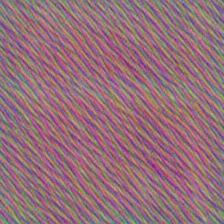

Optimized for 33
. . . . . . . . . . 


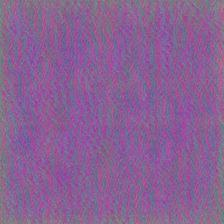

Optimized for 34
. . . . . . . . . . 


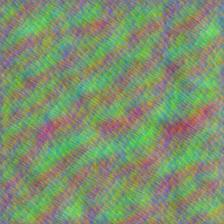

Optimized for 35
. . . . . . . . . . 


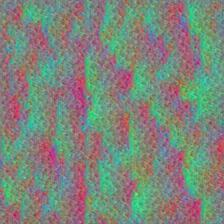

Optimized for 36
. . . . . . . . . . 


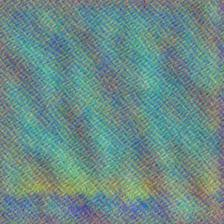

Optimized for 37
. . . . . . . . . . 


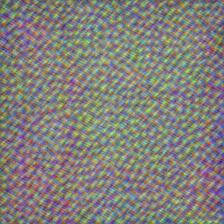

Optimized for 38
. . . . . . . . . . 


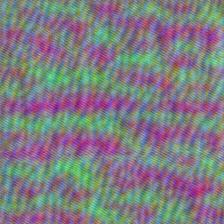

Optimized for 39
. . . . . . . . . . 


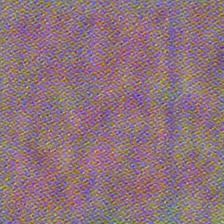

Optimized for 40
. . . . . . . . . . 


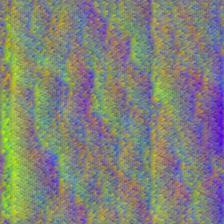

Optimized for 41
. . . . . . . . . . 


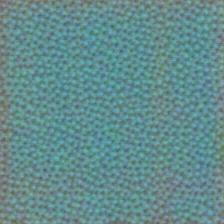

Optimized for 42
. . . . . . . . . . 


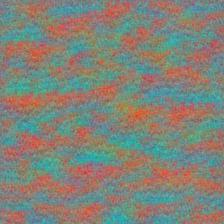

Optimized for 43
. . . . . . . . . . 


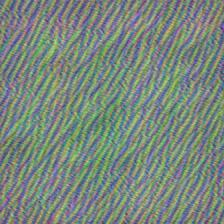

Optimized for 44
. . . . . . . . . . 


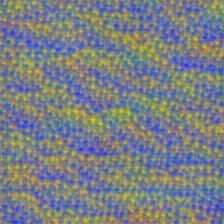

Optimized for 45
. . . . . . . . . . 


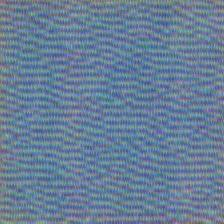

Optimized for 46
. . . . . . . . . . 


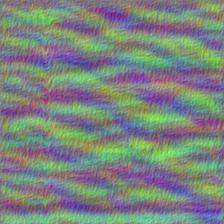

Optimized for 47
. . . . . . . . . . 


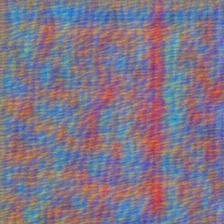

Optimized for 48
. . . . . . . . . . 


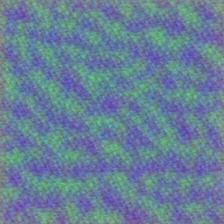

Optimized for 49
. . . . . . . . . . 


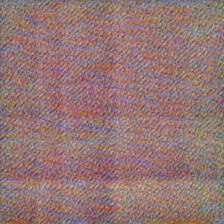

Optimized for 50
. . . . . . . . . . 


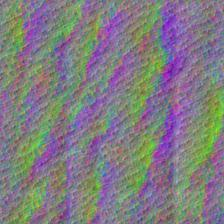

Optimized for 51
. . . . . . . . . . 


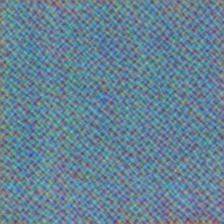

Optimized for 52
. . . . . . . . . . 


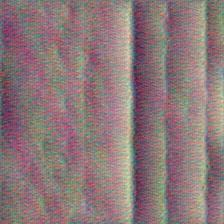

Optimized for 53
. . . . . . . . . . 


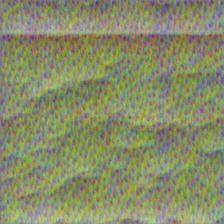

Optimized for 54
. . . . . . . . . . 


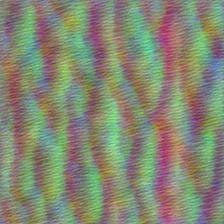

Optimized for 55
. . . . . . . . . . 


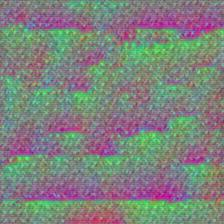

Optimized for 56
. . . . . . . . . . 


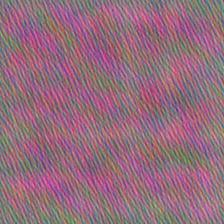

Optimized for 57
. . . . . . . . . . 


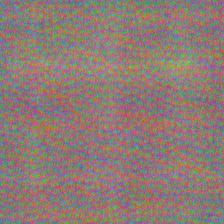

Optimized for 58
. . . . . . . . . . 


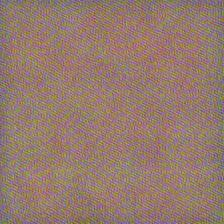

Optimized for 59
. . . . . . . . . . 


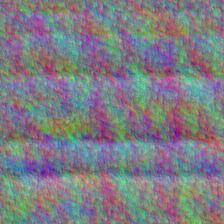

Optimized for 60
. . . . . . . . . . 


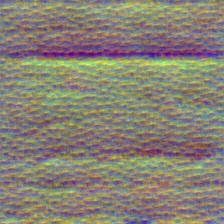

Optimized for 61
. . . . . . . . . . 


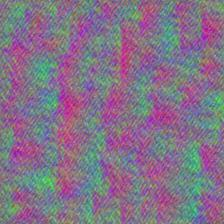

Optimized for 62
. . . . . . . . . . 


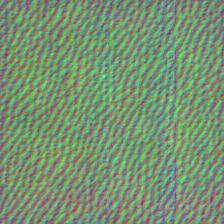

Optimized for 63
. . . . . . . . . . 


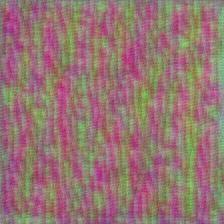

Optimized for 64
. . . . . . . . . . 


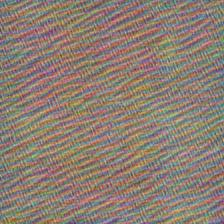

Optimized for 65
. . . . . . . . . . 


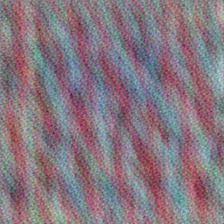

Optimized for 66
. . . . . . . . . . 


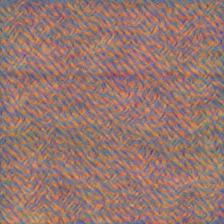

Optimized for 67
. . . . . . . . . . 


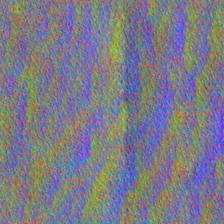

Optimized for 68
. . . . . . . . . . 


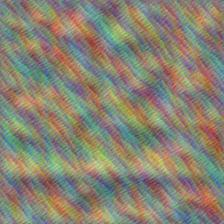

Optimized for 69
. . . . . . . . . . 


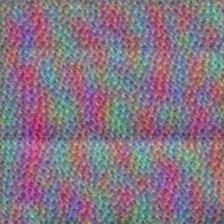

Optimized for 70
. . . . . . . . . . 


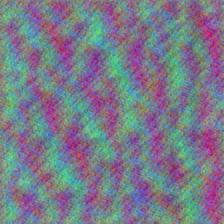

Optimized for 71
. . . . . . . . . . 


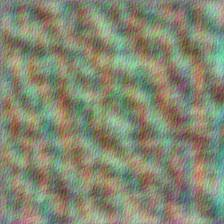

Optimized for 72
. . . . . . . . . . 


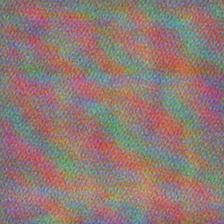

Optimized for 73
. . . . . . . . . . 


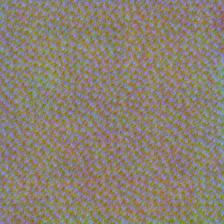

Optimized for 74
. . . . . . . . . . 


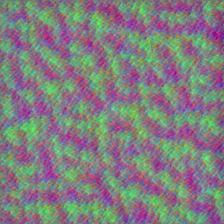

Optimized for 75
. . . . . . . . . . 


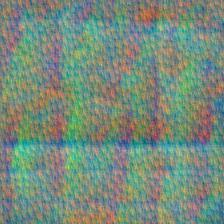

Optimized for 76
. . . . . . . . . . 


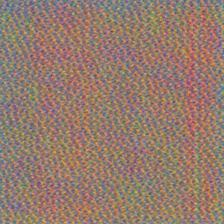

Optimized for 77
. . . . . . . . . . 


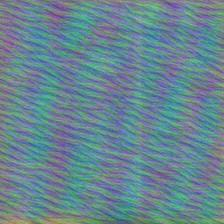

Optimized for 78
. . . . . . . . . . 


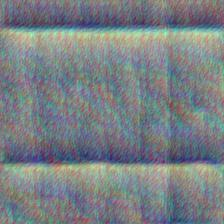

Optimized for 79
. . . . . . . . . . 


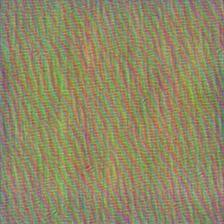

Optimized for 80
. . . . . . . . . . 


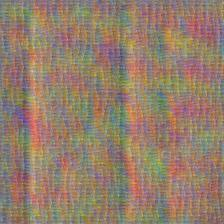

Optimized for 81
. . . . . . . . . . 


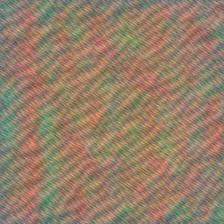

Optimized for 82
. . . . . . . . . . 


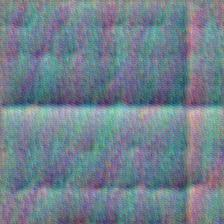

Optimized for 83
. . . . . . . . . . 


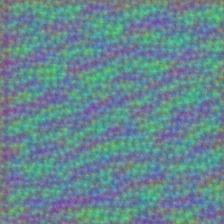

Optimized for 84
. . . . . . . . . . 


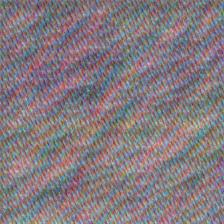

Optimized for 85
. . . . . . . . . . 


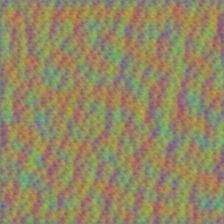

Optimized for 86
. . . . . . . . . . 


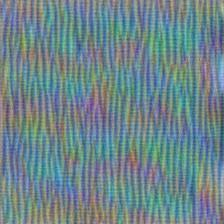

Optimized for 87
. . . . . . . . . . 


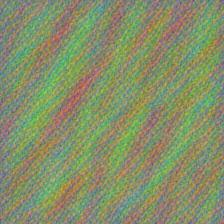

Optimized for 88
. . . . . . . . . . 


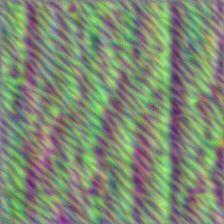

Optimized for 89
. . . . . . . . . . 


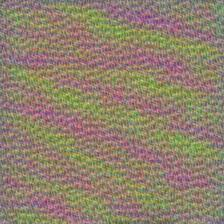

Optimized for 90
. . . . . . . . . . 


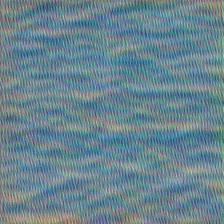

Optimized for 91
. . . . . . . . . . 


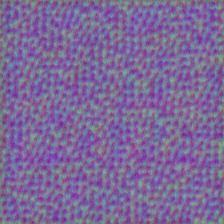

Optimized for 92
. . . . . . . . . . 


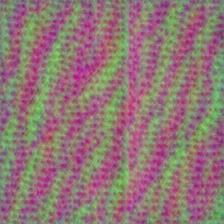

Optimized for 93
. . . . . . . . . . 


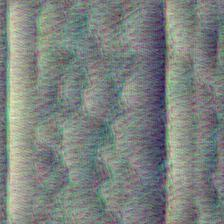

Optimized for 94
. . . . . . . . . . 


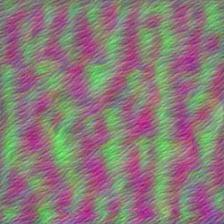

Optimized for 95
. . . . . . . . . . 


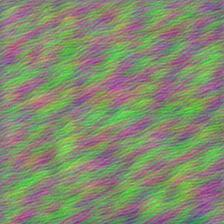

Optimized for 96
. . . . . . . . . . 


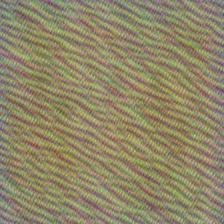

Optimized for 97
. . . . . . . . . . 


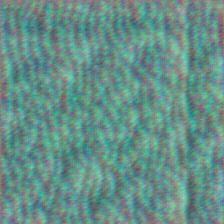

Optimized for 98
. . . . . . . . . . 


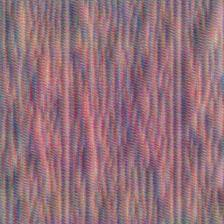

Optimized for 99
. . . . . . . . . . 


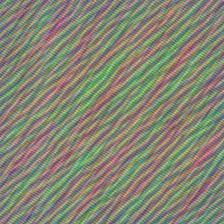

Optimized for 100
. . . . . . . . . . 


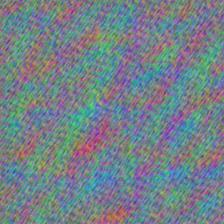

Optimized for 101
. . . . . . . . . . 


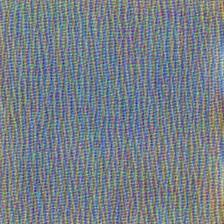

Optimized for 102
. . . . . . . . . . 


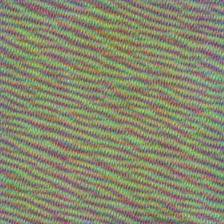

Optimized for 103
. . . . . . . . . . 


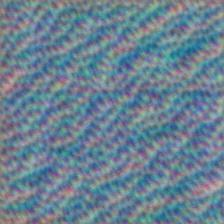

Optimized for 104
. . . . . . . . . . 


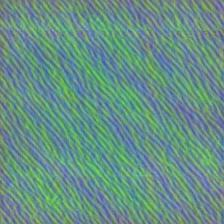

Optimized for 105
. . . . . . . . . . 


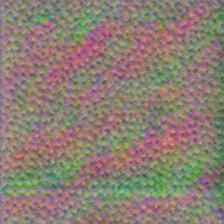

Optimized for 106
. . . . . . . . . . 


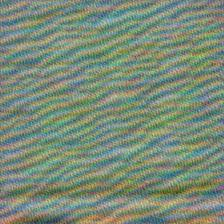

Optimized for 107
. . . . . . . . . . 


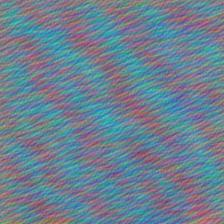

Optimized for 108
. . . . . . . . . . 


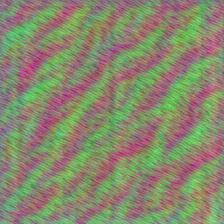

Optimized for 109
. . . . . . . . . . 


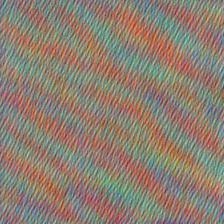

Optimized for 110
. . . . . . . . . . 


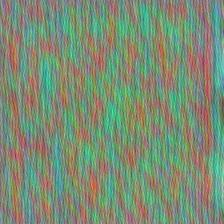

Optimized for 111
. . . . . . . . . . 


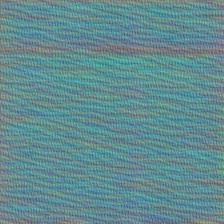

Optimized for 112
. . . . . . . . . . 


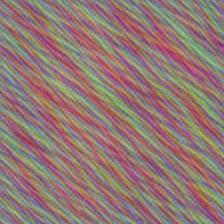

Optimized for 113
. . . . . . . . . . 


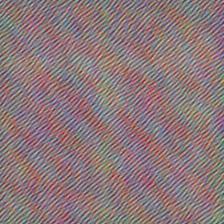

Optimized for 114
. . . . . . . . . . 


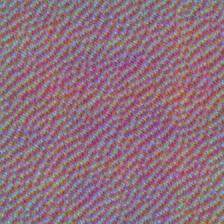

Optimized for 115
. . . . . . . . . . 


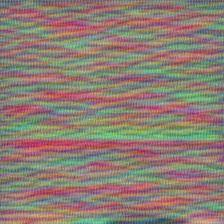

Optimized for 116
. . . . . . . . . . 


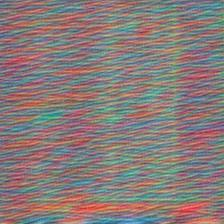

Optimized for 117
. . . . . . . . . . 


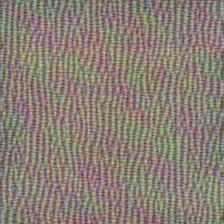

Optimized for 118
. . . . . . . . . . 


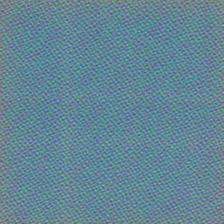

Optimized for 119
. . . . . . . . . . 


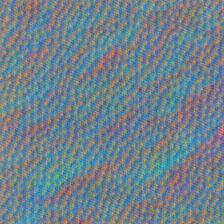

Optimized for 120
. . . . . . . . . . 


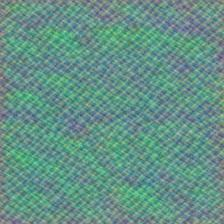

Optimized for 121
. . . . . . . . . . 


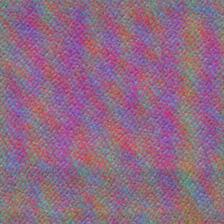

Optimized for 122
. . . . . . . . . . 


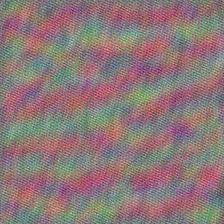

Optimized for 123
. . . . . . . . . . 


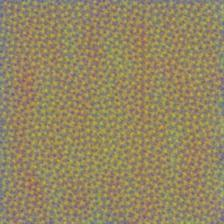

Optimized for 124
. . . . . . . . . . 


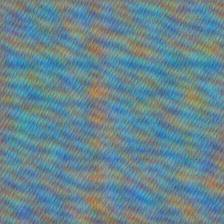

Optimized for 125
. . . . . . . . . . 


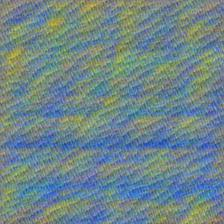

Optimized for 126
. . . . . . . . . . 


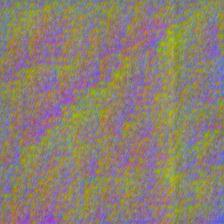

Optimized for 127
. . . . . . . . . . 


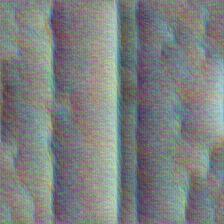

Optimized for 128
. . . . . . . . . . 


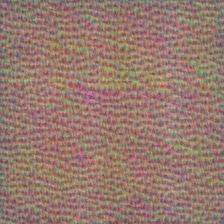

Optimized for 129
. . . . . . . . . . 


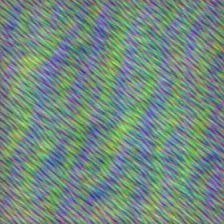

Optimized for 130
. . . . . . . . . . 


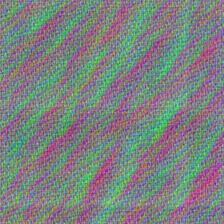

Optimized for 131
. . . . . . . . . . 


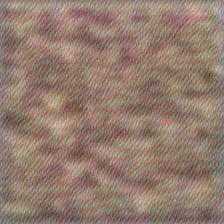

Optimized for 132
. . . . . . . . . . 


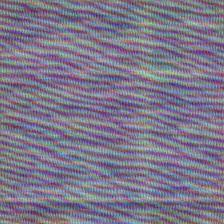

Optimized for 133
. . . . . . . . . . 


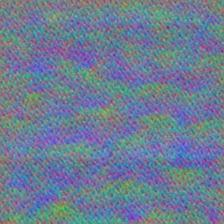

Optimized for 134
. . . . . . . . . . 


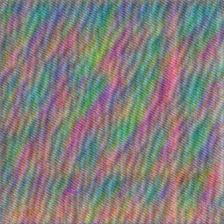

Optimized for 135
. . . . . . . . . . 


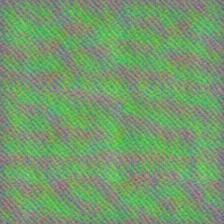

Optimized for 136
. . . . . . . . . . 


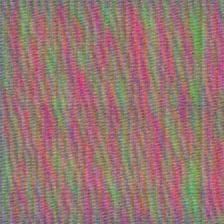

Optimized for 137
. . . . . . . . . . 


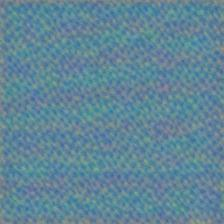

Optimized for 138
. . . . . . . . . . 


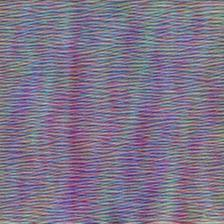

Optimized for 139
. . . . . . . . . . 


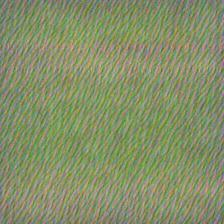

Optimized for 140
. . . . . . . . . . 


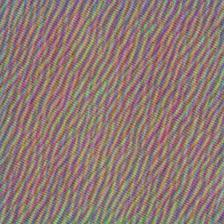

Optimized for 141
. . . . . . . . . . 


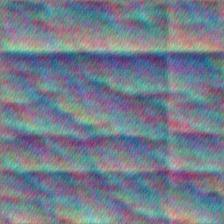

Optimized for 142
. . . . . . . . . . 


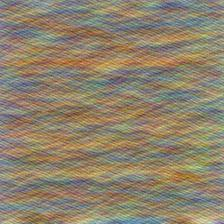

Optimized for 143
. . . . . . . . . . 


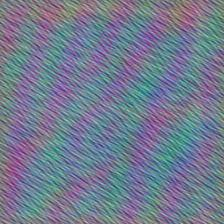

Optimized for 144
. . . . . . . . . . 


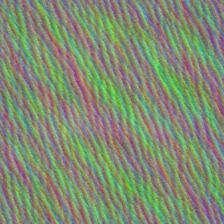

Optimized for 145
. . . . . . . . . . 


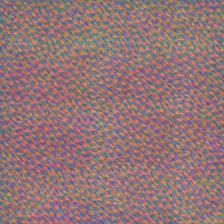

Optimized for 146
. . . . . . . . . . 


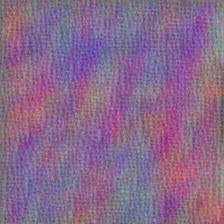

Optimized for 147
. . . . . . . . . . 


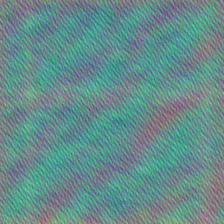

Optimized for 148
. . . . . . . . . . 


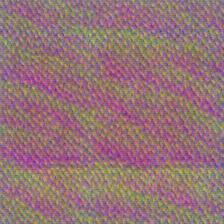

Optimized for 149
. . . . . . . . . . 


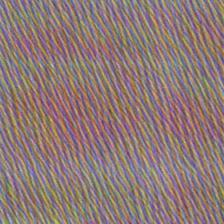

Optimized for 150
. . . . . . . . . . 


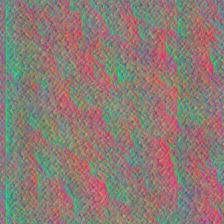

Optimized for 151
. . . . . . . . . . 


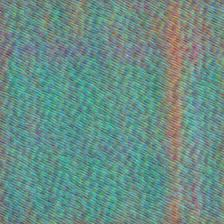

Optimized for 152
. . . . . . . . . . 


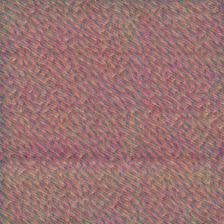

Optimized for 153
. . . . . . . . . . 


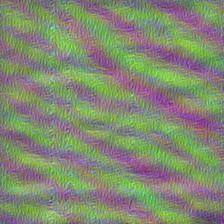

Optimized for 154
. . . . . . . . . . 


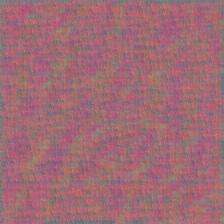

Optimized for 155
. . . . . . . . . . 


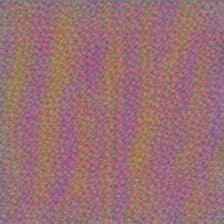

Optimized for 156
. . . . . . . . . . 


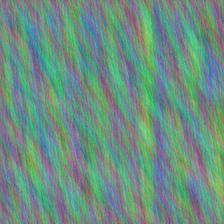

Optimized for 157
. . . . . . . . . . 


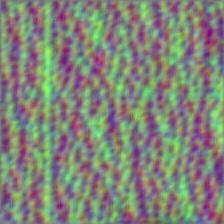

Optimized for 158
. . . . . . . . . . 


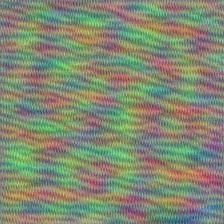

Optimized for 159
. . . . . . . . . . 


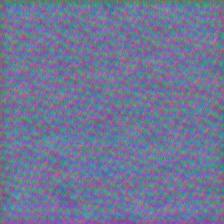

Optimized for 160
. . . . . . . . . . 


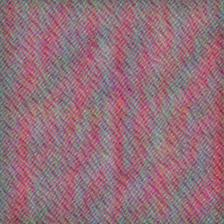

Optimized for 161
. . . . . . . . . . 


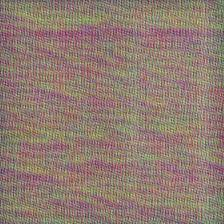

Optimized for 162
. . . . . . . . . . 


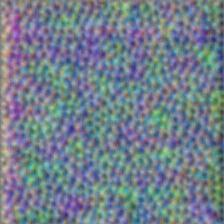

Optimized for 163
. . . . . . . . . . 


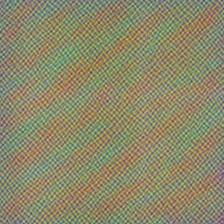

Optimized for 164
. . . . . . . . . . 


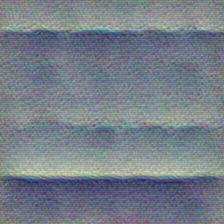

Optimized for 165
. . . . . . . . . . 


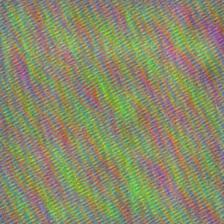

Optimized for 166
. . . . . . . . . . 


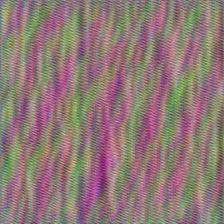

Optimized for 167
. . . . . . . . . . 


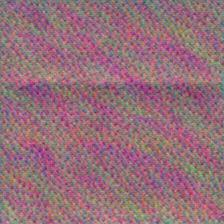

Optimized for 168
. . . . . . . . . . 


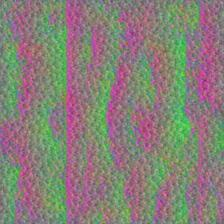

Optimized for 169
. . . . . . . . . . 


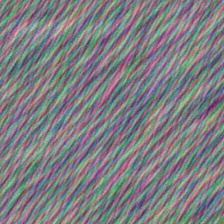

Optimized for 170
. . . . . . . . . . 


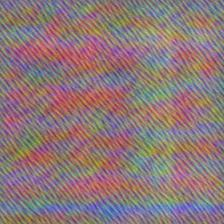

Optimized for 171
. . . . . . . . . . 


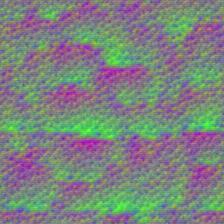

Optimized for 172
. . . . . . . . . . 


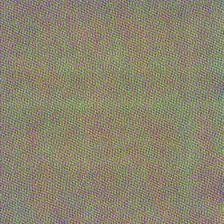

Optimized for 173
. . . . . . . . . . 


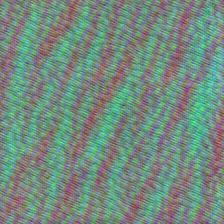

Optimized for 174
. . . . . . . . . . 


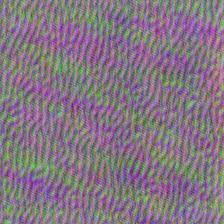

Optimized for 175
. . . . . . . . . . 


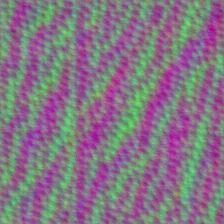

Optimized for 176
. . . . . . . . . . 


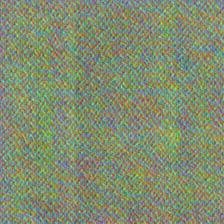

Optimized for 177
. . . . . . . . . . 


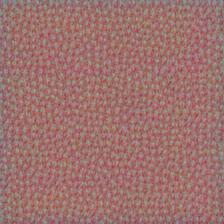

Optimized for 178
. . . . . . . . . . 


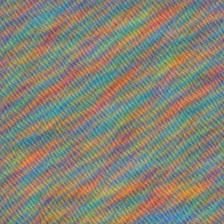

Optimized for 179
. . . . . . . . . . 


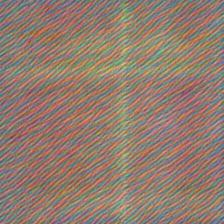

Optimized for 180
. . . . . . . . . . 


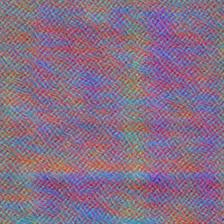

Optimized for 181
. . . . . . . . . . 


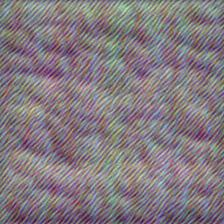

Optimized for 182
. . . . . . . . . . 


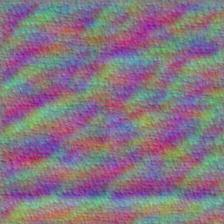

Optimized for 183
. . . . . . . . . . 


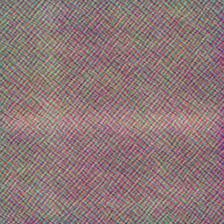

Optimized for 184
. . . . . . . . . . 


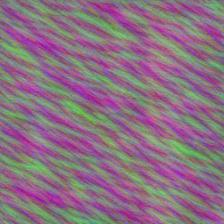

Optimized for 185
. . . . . . . . . . 


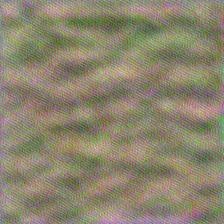

Optimized for 186
. . . . . . . . . . 


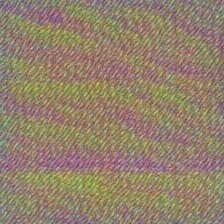

Optimized for 187
. . . . . . . . . . 


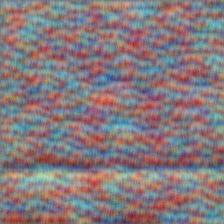

Optimized for 188
. . . . . . . . . . 


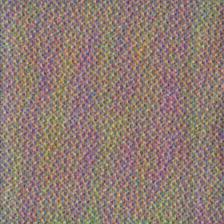

Optimized for 189
. . . . . . . . . . 


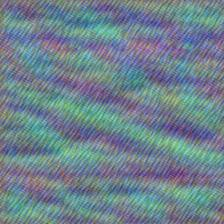

Optimized for 190
. . . . . . . . . . 


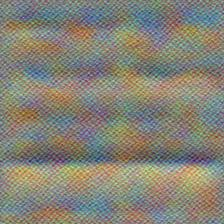

Optimized for 191


In [35]:
VisualizeLayer('conv2d2_pre_relu')

## Low level (deep) features

As we go further down into the network, the networks ability to represent complex objects can be shown through the process of backpropagation and deep dream. 

We get more of the potential to describe complex objects. This leads to the potential to classify different objects while reusing certain logic. We create a very highly purposed network with a wide range of objects that it can classify. 

![](tensorflow-1.gif)





. . . . . . . . . . 


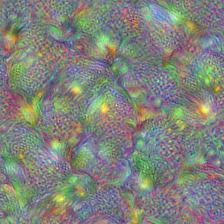

Optimized for 0
. . . . . . . . . . 


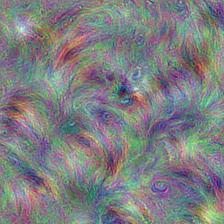

Optimized for 1
. . . . . . . . . . 


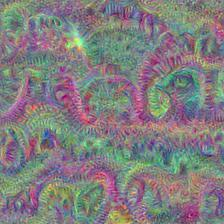

Optimized for 2
. . . . . . . . . . 


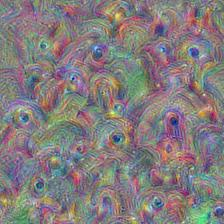

Optimized for 3
. . . . . . . . . . 


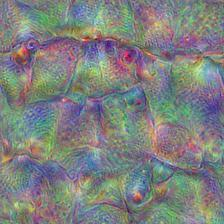

Optimized for 4
. . . . . . . . . . 


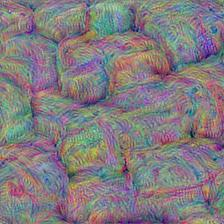

Optimized for 5
. . . . . . . . . . 


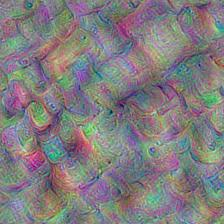

Optimized for 6
. . . . . . . . . . 


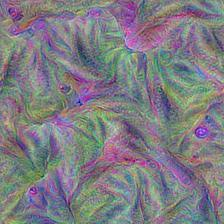

Optimized for 7
. . . . . . . . . . 


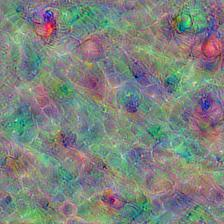

Optimized for 8
. . . . . . . . . . 


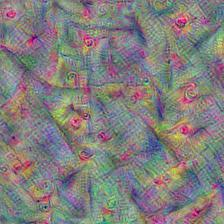

Optimized for 9
. . . . . . . . . . 


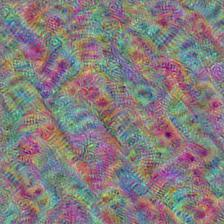

Optimized for 10
. . . . . . . . . . 


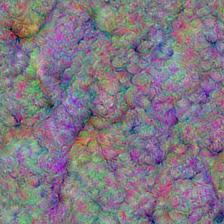

Optimized for 11
. . . . . . . . . . 


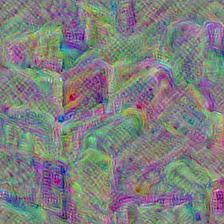

Optimized for 12
. . . . . . . . . . 


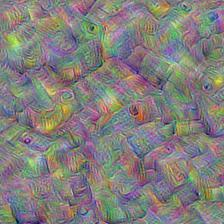

Optimized for 13
. . . . . . . . . . 


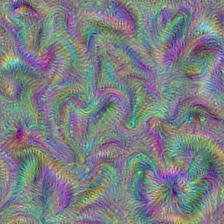

Optimized for 14
. . . . . . . . . . 


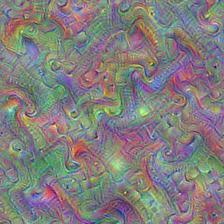

Optimized for 15
. . . . . . . . . . 


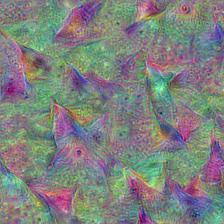

Optimized for 16
. . . . . . . . . . 


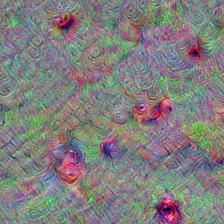

Optimized for 17
. . . . . . . . . . 


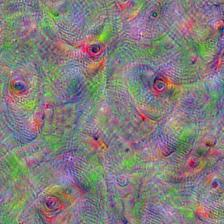

Optimized for 18
. . . . . . . . . . 


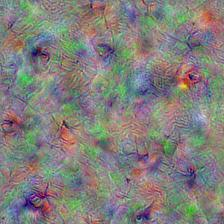

Optimized for 19
. . . . . . . . . . 


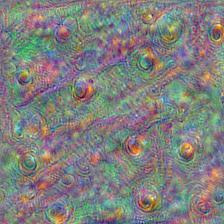

Optimized for 20
. . . . . . . . . . 


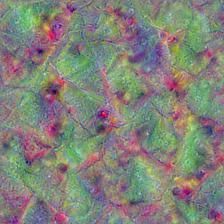

Optimized for 21
. . . . . . . . . . 


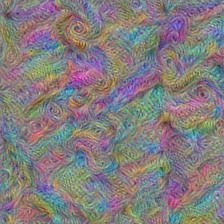

Optimized for 22
. . . . . . . . . . 


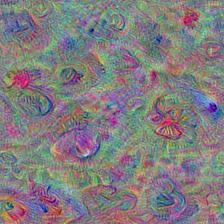

Optimized for 23
. . . . . . . . . . 


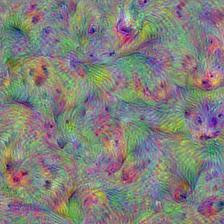

Optimized for 24
. . . . . . . . . . 


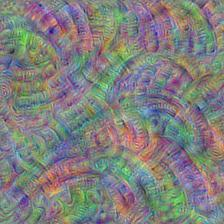

Optimized for 25
. . . . . . . . . . 


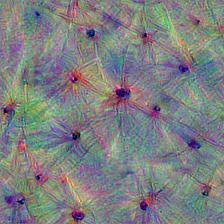

Optimized for 26
. . . . . . . . . . 


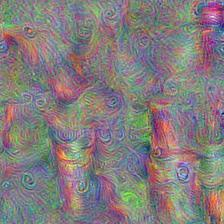

Optimized for 27
. . . . . . . . . . 


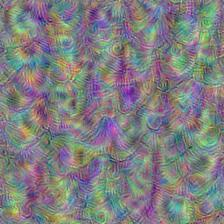

Optimized for 28
. . . . . . . . . . 


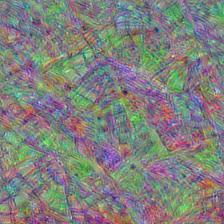

Optimized for 29
. . . . . . . . . . 


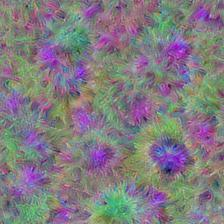

Optimized for 30
. . . . . . . . . . 


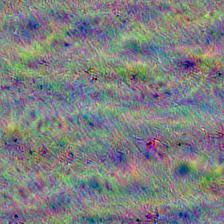

Optimized for 31
. . . . . . . . . . 


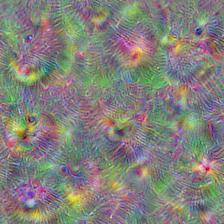

Optimized for 32
. . . . . . . . . . 


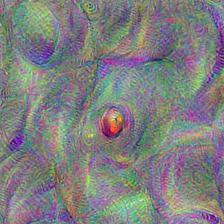

Optimized for 33
. . . . . . . . . . 


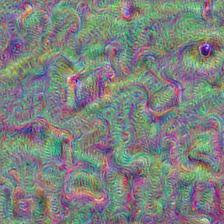

Optimized for 34
. . . . . . . . . . 


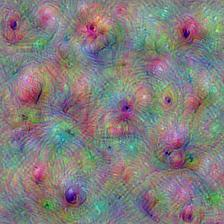

Optimized for 35
. . . . . . . . . . 


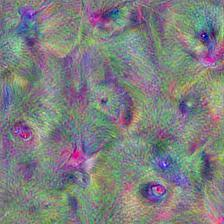

Optimized for 36
. . . . . . . . . . 


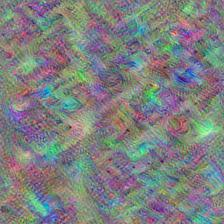

Optimized for 37
. . . . . . . . . . 


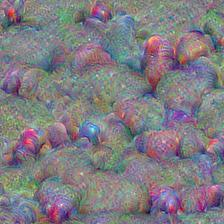

Optimized for 38
. . . . . . . . . . 


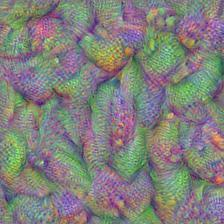

Optimized for 39
. . . . . . . . . . 


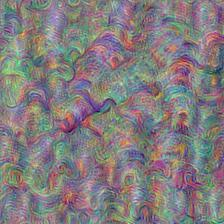

Optimized for 40
. . . . . . . . . . 


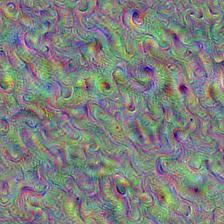

Optimized for 41
. . . . . . . . . . 


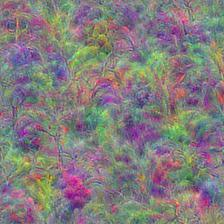

Optimized for 42
. . . . . . . . . . 


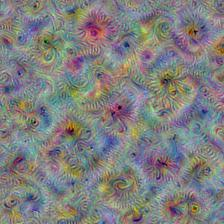

Optimized for 43
. . . . . . . . . . 


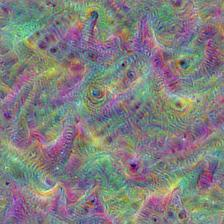

Optimized for 44
. . . . . . . . . . 


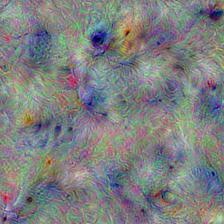

Optimized for 45
. . . . . . . . . . 


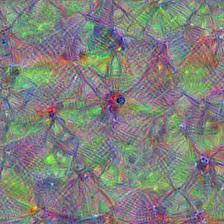

Optimized for 46
. . . . . . . . . . 


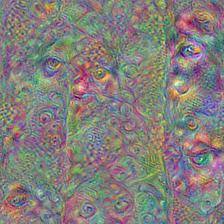

Optimized for 47
. . . . . . . . . . 


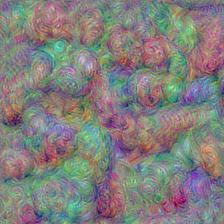

Optimized for 48
. . . . . . . . . . 


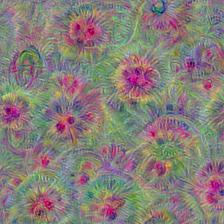

Optimized for 49
. . . . . . . . . . 


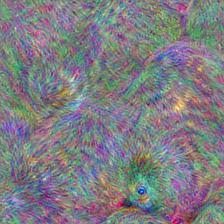

Optimized for 50
. . . . . . . . . . 


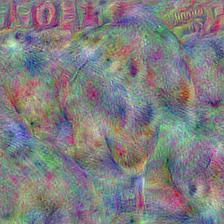

Optimized for 51
. . . . . . . . . . 


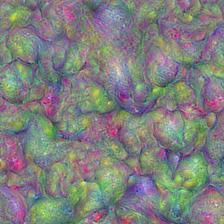

Optimized for 52
. . . . . . . . . . 


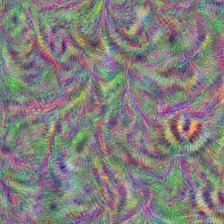

Optimized for 53
. . . . . . . . . . 


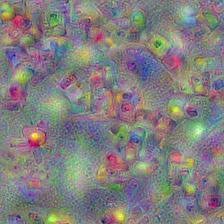

Optimized for 54
. . . . . . . . . . 


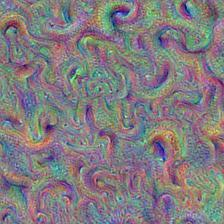

Optimized for 55
. . . . . . . . . . 


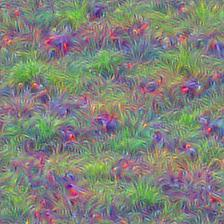

Optimized for 56
. . . . . . . . . . 


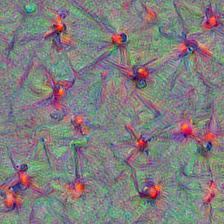

Optimized for 57
. . . . . . . . . . 


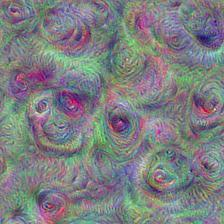

Optimized for 58
. . . . . . . . . . 


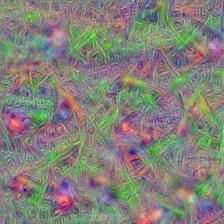

Optimized for 59
. . . . . . . . . . 


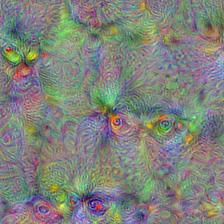

Optimized for 60
. . . . . . . . . . 


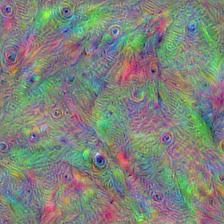

Optimized for 61
. . . . . . . . . . 


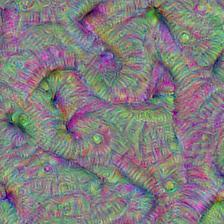

Optimized for 62
. . . . . . . . . . 


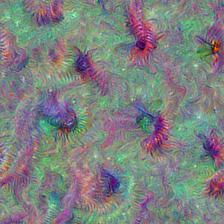

Optimized for 63
. . . . . . . . . . 


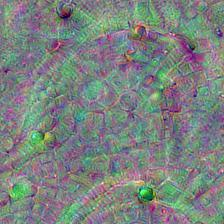

Optimized for 64
. . . . . . . . . . 


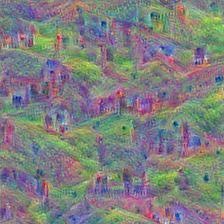

Optimized for 65
. . . . . . . . . . 


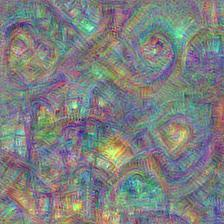

Optimized for 66
. . . . . . . . . . 


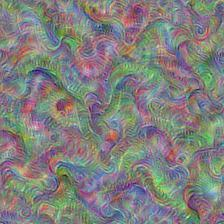

Optimized for 67
. . . . . . . . . . 


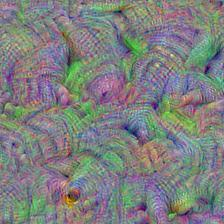

Optimized for 68
. . . . . . . . . . 


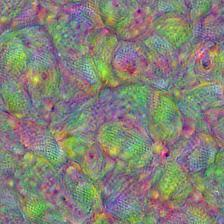

Optimized for 69
. . . . . . . . . . 


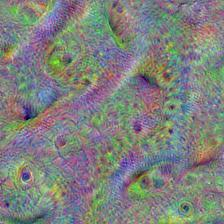

Optimized for 70
. . . . . . . . . . 


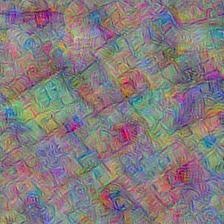

Optimized for 71
. . . . . . . . . . 


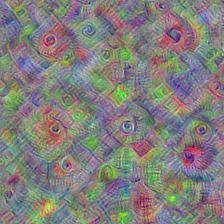

Optimized for 72
. . . . . . . . . . 


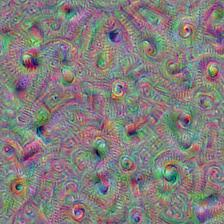

Optimized for 73
. . . . . . . . . . 


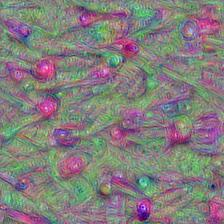

Optimized for 74
. . . . . . . . . . 


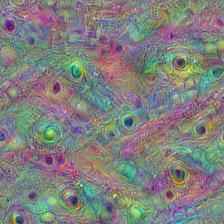

Optimized for 75
. . . . . . . . . . 


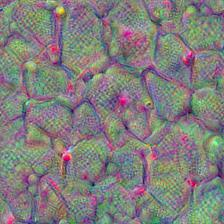

Optimized for 76
. . . . . . . . . . 


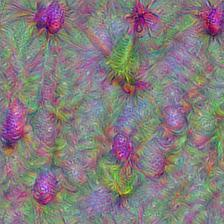

Optimized for 77
. . . . . . . . . . 


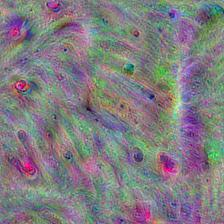

Optimized for 78
. . . . . . . . . . 


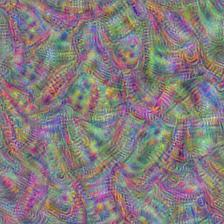

Optimized for 79
. . . . . . . . . . 


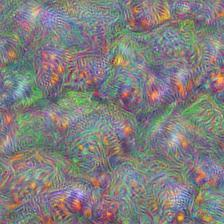

Optimized for 80
. . . . . . . . . . 


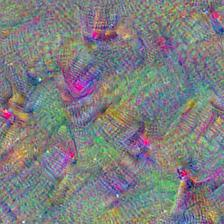

Optimized for 81
. . . . . . . . . . 


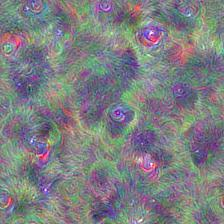

Optimized for 82
. . . . . . . . . . 


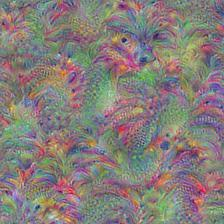

Optimized for 83
. . . . . . . . . . 


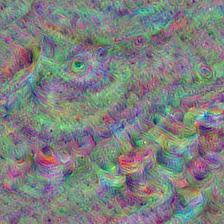

Optimized for 84
. . . . . . . . . . 


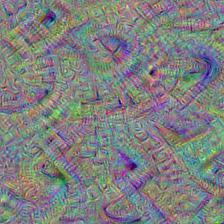

Optimized for 85
. . . . . . . . . . 


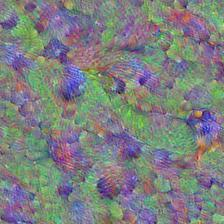

Optimized for 86
. . . . . . . . . . 


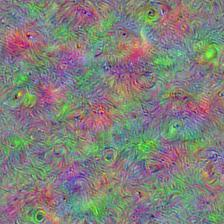

Optimized for 87
. . . . . . . . . . 


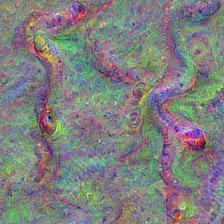

Optimized for 88
. . . . . . . . . . 


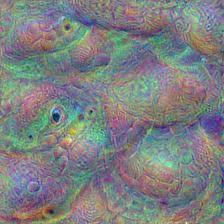

Optimized for 89
. . . . . . . . . . 


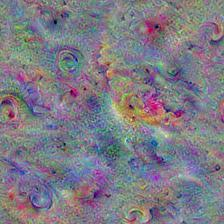

Optimized for 90
. . . . . . . . . . 


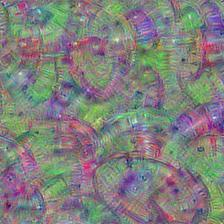

Optimized for 91
. . . . . . . . . . 


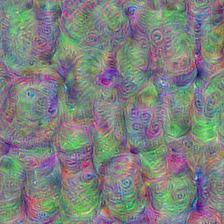

Optimized for 92
. . . . . . . . . . 


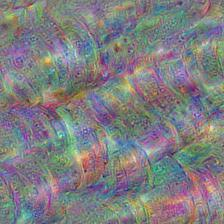

Optimized for 93
. . . . . . . . . . 


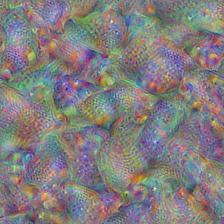

Optimized for 94
. . . . . . . . . . 


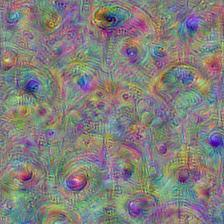

Optimized for 95
. . . . . . . . . . 


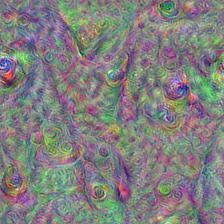

Optimized for 96
. . . . . . . . . . 


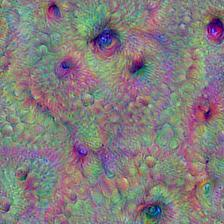

Optimized for 97
. . . . . . . . . . 


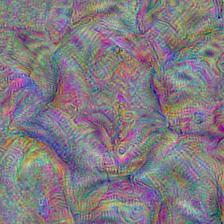

Optimized for 98
. . . . . . . . . . 


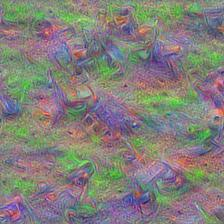

Optimized for 99
. . . . . . . . . . 


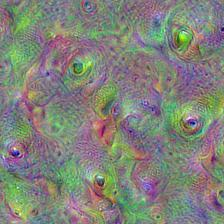

Optimized for 100
. . . . . . . . . . 


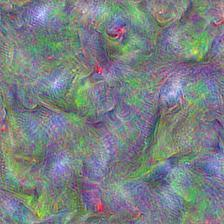

Optimized for 101
. . . . . . . . . . 


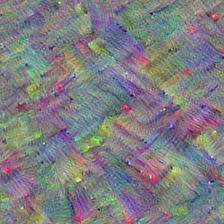

Optimized for 102
. . . . . . . . . . 


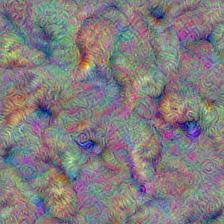

Optimized for 103
. . . . . . . . . . 


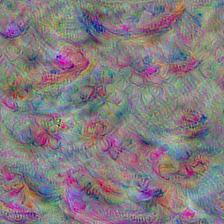

Optimized for 104
. . . . . . . . . . 


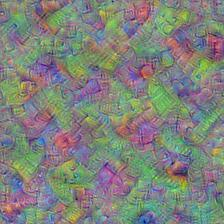

Optimized for 105
. . . . . . . . . . 


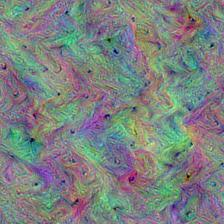

Optimized for 106
. . . . . . . . . . 


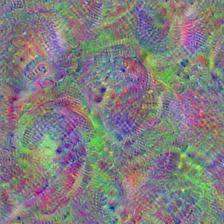

Optimized for 107
. . . . . . . . . . 


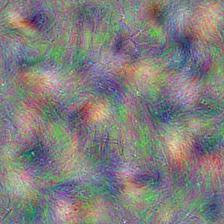

Optimized for 108
. . . . . . . . . . 


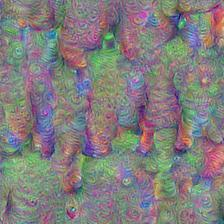

Optimized for 109
. . . . . . . . . . 


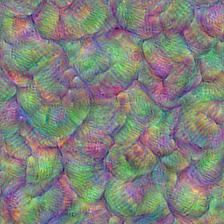

Optimized for 110
. . . . . . . . . . 


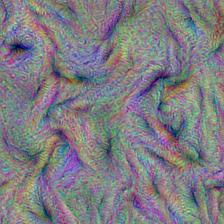

Optimized for 111
. . . . . . . . . . 


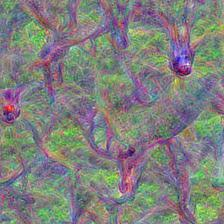

Optimized for 112
. . . . . . . . . . 


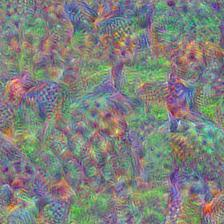

Optimized for 113
. . . . . . . . . . 


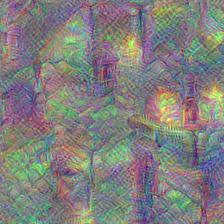

Optimized for 114
. . . . . . . . . . 


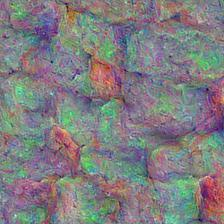

Optimized for 115
. . . . . . . . . . 


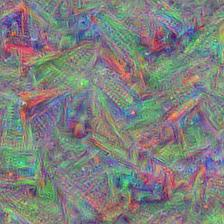

Optimized for 116
. . . . . . . . . . 


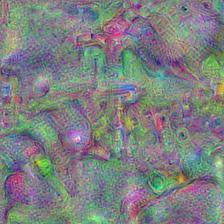

Optimized for 117
. . . . . . . . . . 


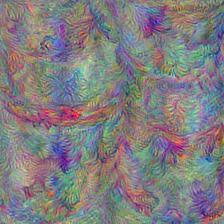

Optimized for 118
. . . . . . . . . . 


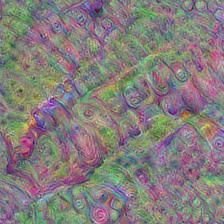

Optimized for 119
. . . . . . . . . . 


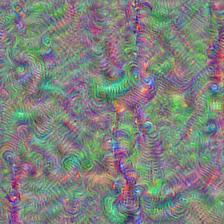

Optimized for 120
. . . . . . . . . . 


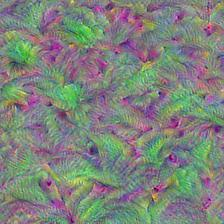

Optimized for 121
. . . . . . . . . . 


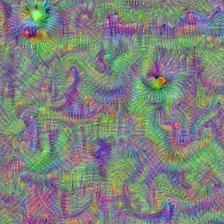

Optimized for 122
. . . . . . . . . . 


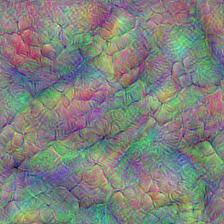

Optimized for 123
. . . . . . . . . . 


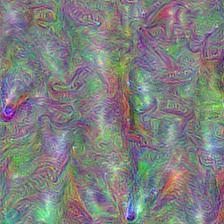

Optimized for 124
. . . . . . . . . . 


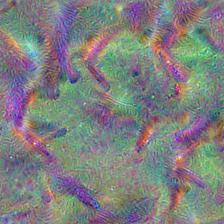

Optimized for 125
. . . . . . . . . . 


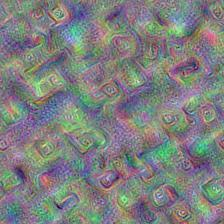

Optimized for 126
. . . . . . . . . . 


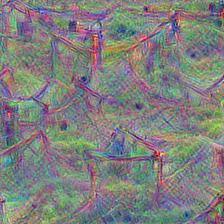

Optimized for 127
. . . . . . . . . . 


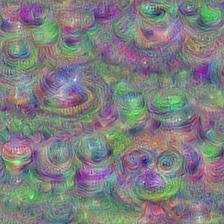

Optimized for 128
. . . . . . . . . . 


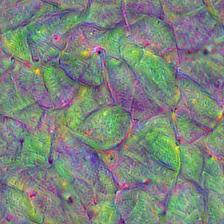

Optimized for 129
. . . . . . . . . . 


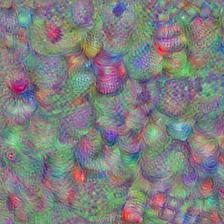

Optimized for 130
. . . . . . . . . . 


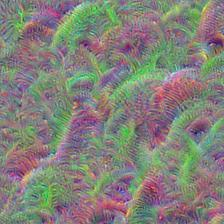

Optimized for 131
. . . . . . . . . . 


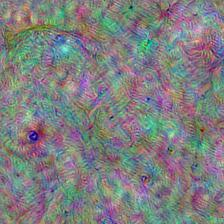

Optimized for 132
. . . . . . . . . . 


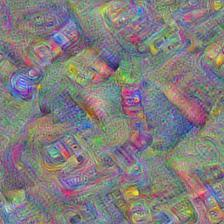

Optimized for 133
. . . . . . . . . . 


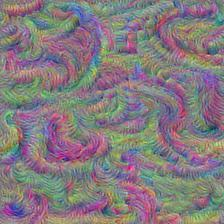

Optimized for 134
. . . . . . . . . . 


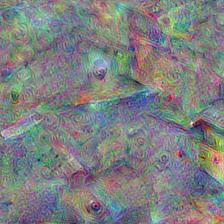

Optimized for 135
. . . . . . . . . . 


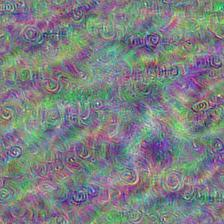

Optimized for 136
. . . . . . . . . . 


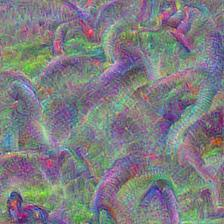

Optimized for 137
. . . . . . . . . . 


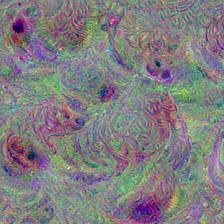

Optimized for 138
. . . . . . . . . . 


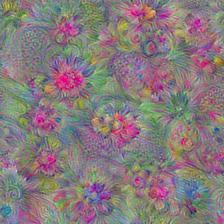

Optimized for 139
. . . . . . . . . . 


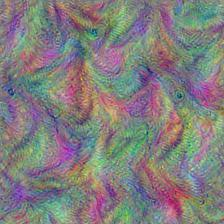

Optimized for 140
. . . . . . . . . . 


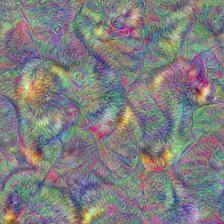

Optimized for 141
. . . . . . . . . . 


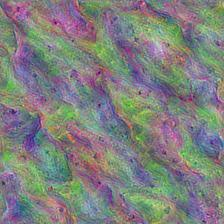

Optimized for 142
. . . . . . . . . . 


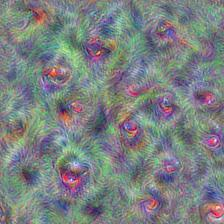

Optimized for 143


In [36]:
VisualizeLayer('mixed4d_3x3_bottleneck_pre_relu')

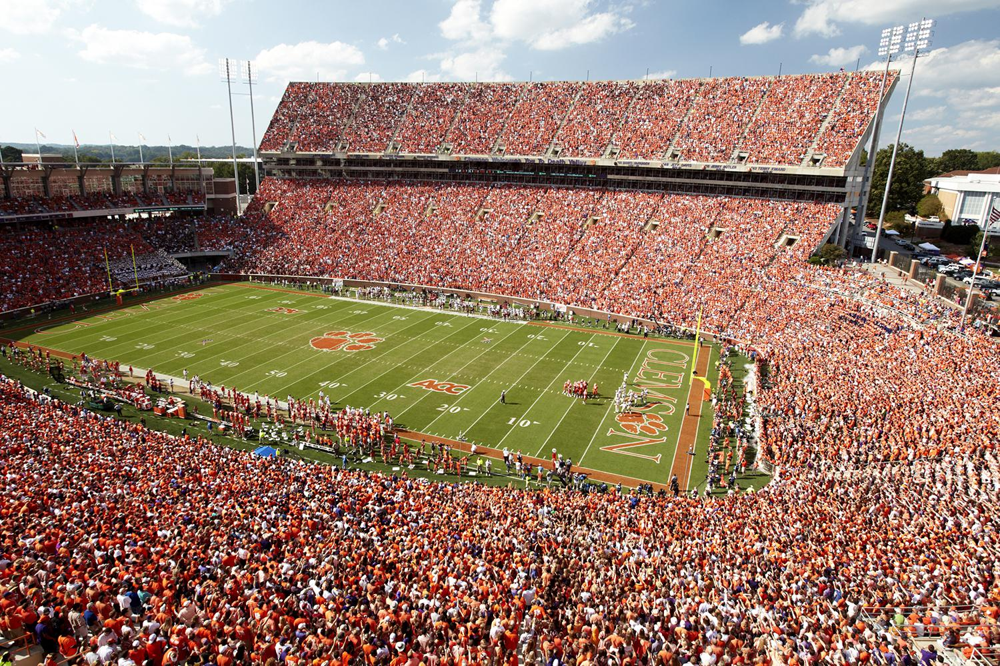

In [41]:
img2 = PIL.Image.open('bigger_stadium.jpg')
img2 = np.float32(img2)
showarray(img2/255.0)

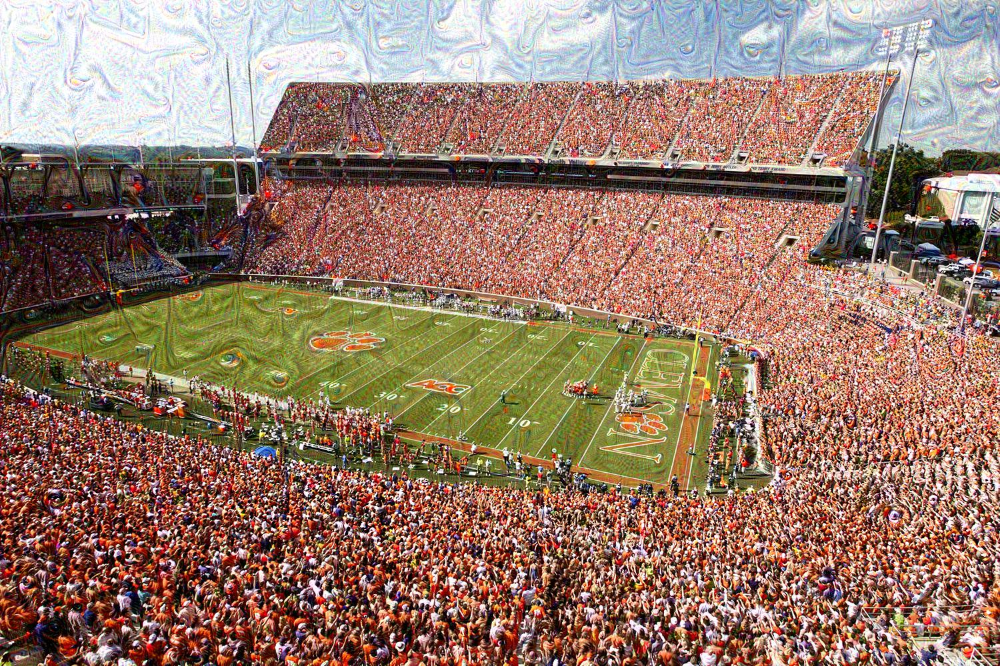

In [38]:
cool_looking_layer = 'mixed4d_3x3_bottleneck_pre_relu'
its_optimization_weights_index = 143

interesting_image = render_deepdream(
    T(cool_looking_layer)[:,:,:,its_optimization_weights_index], 
    img2
)

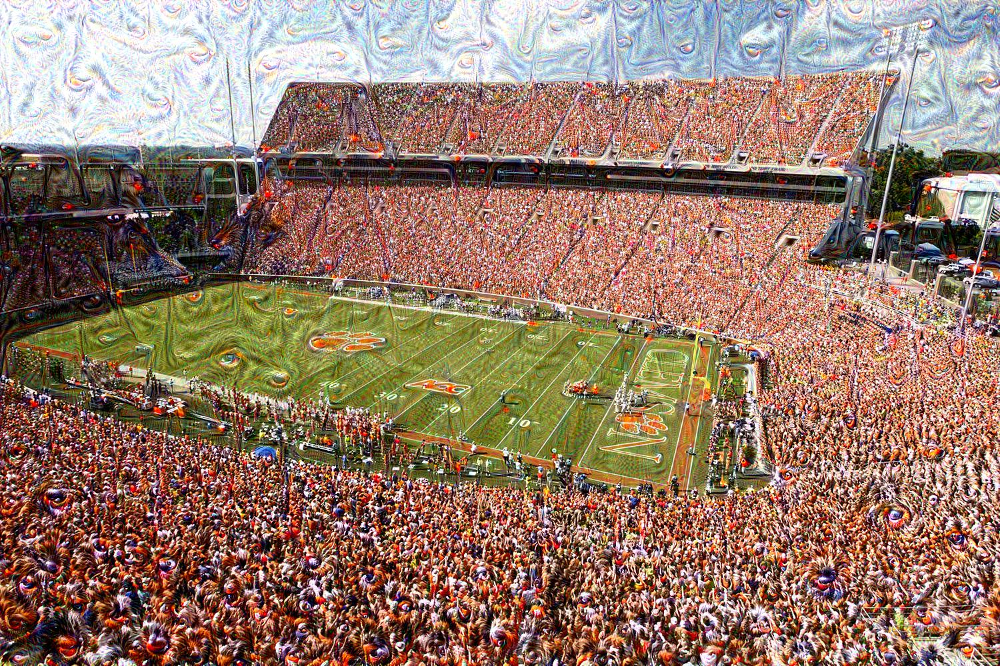

In [39]:
# repeat to enhance
repeatedCall = render_deepdream(
    T(cool_looking_layer)[:,:,:,its_optimization_weights_index], 
    interesting_image
)

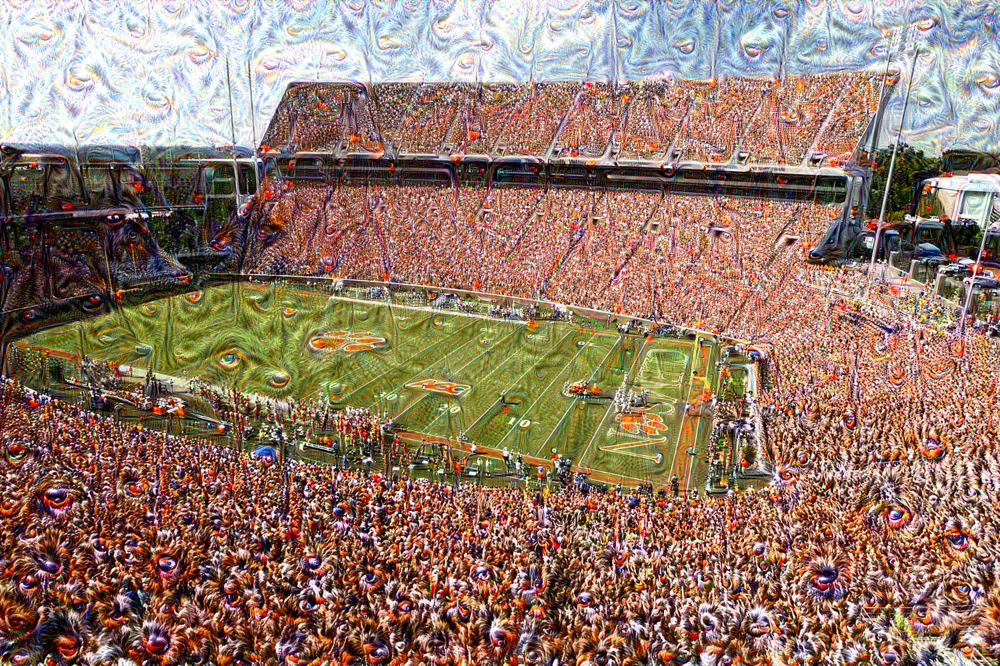

In [40]:
final = render_deepdream(
    T(cool_looking_layer)[:,:,:,its_optimization_weights_index], 
    repeatedCall
)

# we now have spooky doggo's 

# Test other features that are looked for by the network

With the visualization of the layers, we can now browse through the different accenuated features and apply those particular layers to images.

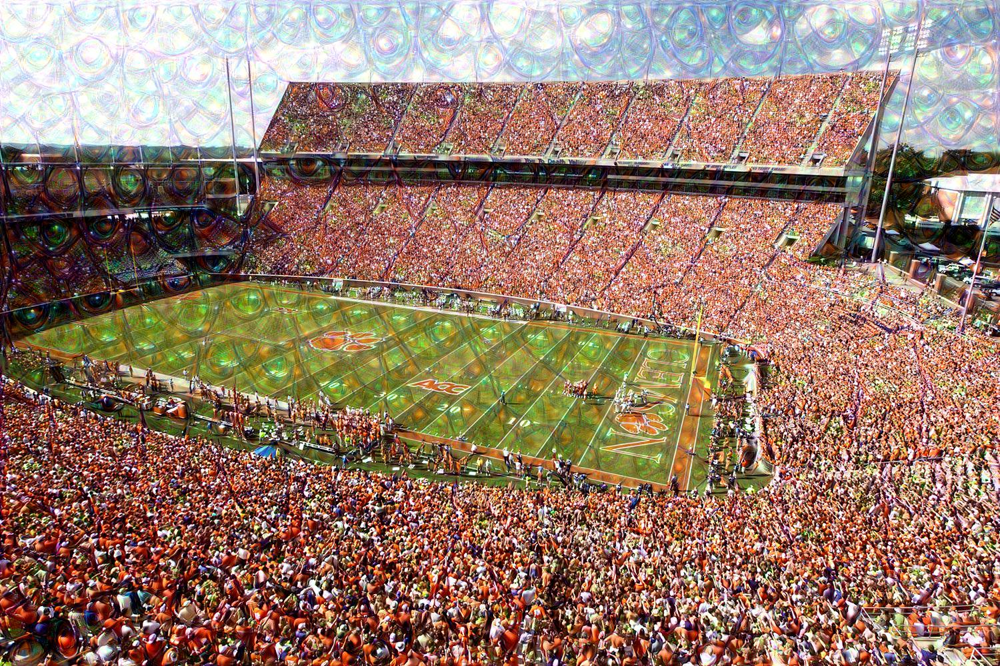

In [123]:
fancy = render_deepdream(T('mixed4b_1x1_pre_relu')[:,:,:,0], img2)

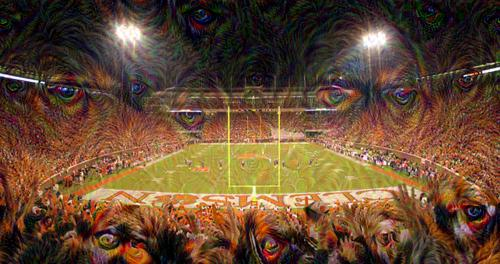

In [125]:
other_doggy_layer_viz = render_deepdream(T('mixed4c_pool_reduce_pre_relu')[:,:,:,0], img1)